# Figure 2

Pancreatic Endocrinogenesis Dataset

In [1]:
import scvelo as scv
import scanpy as sc
import numpy as np
import sklearn
import scipy
import pandas as pd
import seaborn as sns
import pickle
scv.set_figure_params()

## Data Preprocessing

In [9]:
adata = scv.datasets.pancreas()
adata_raw = adata.copy()

In [10]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.filter_and_normalize(adata_raw, log=False, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

Filtered out 20801 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
Filtered out 20801 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
computing neighbors
    finished (0:00:06) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


recovering dynamics (using 2/28 cores)
or disable the progress bar using `show_progress_bar=False`.
    finished (0:04:38) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 2/28 cores)
    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


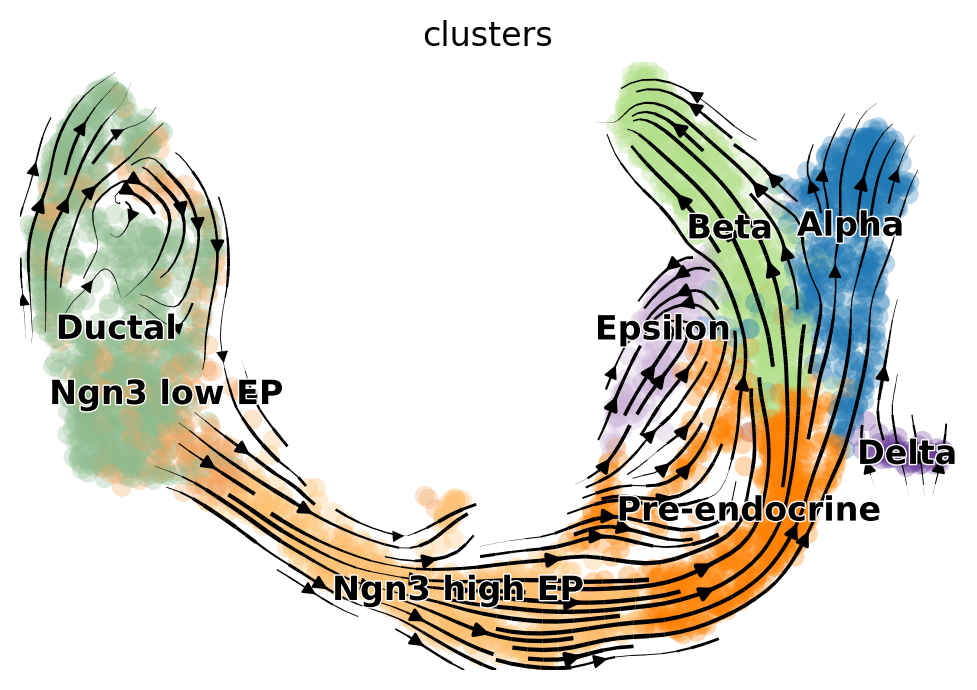

computing terminal states
    identified 2 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


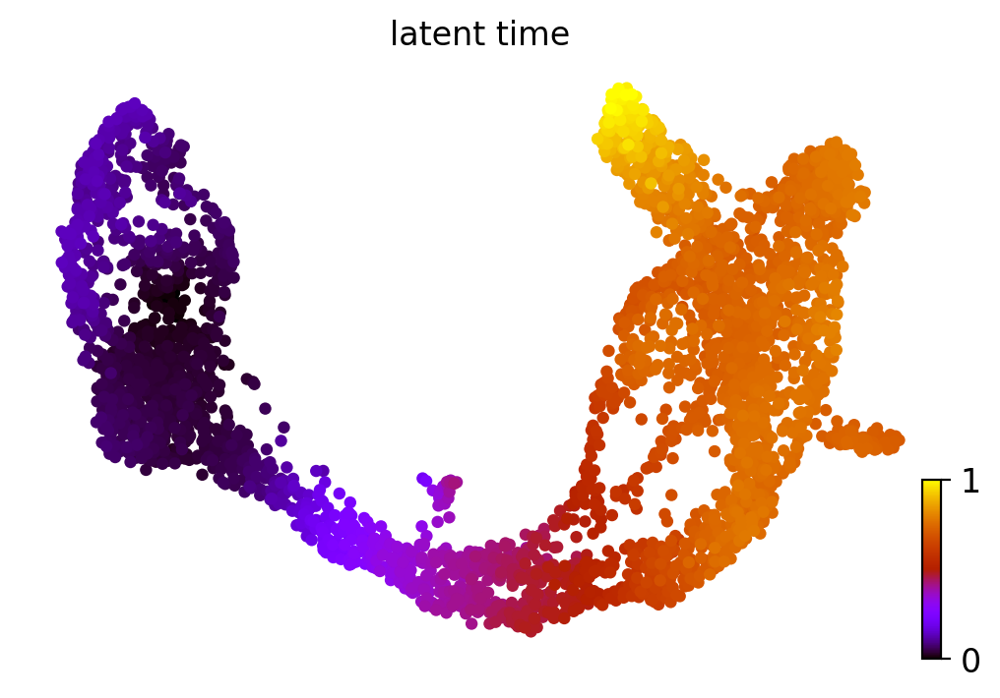

In [4]:
# Extract dynamical velocity vectors
scv.tl.recover_dynamics(adata, n_jobs=2)
scv.tl.velocity(adata, mode='dynamical', use_raw=True)
scv.tl.velocity_graph(adata, n_jobs=2)
scv.pl.velocity_embedding_stream(adata, basis='umap')

# Latent time inference
scv.tl.latent_time(adata)
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=80)

In [11]:
#adata.write("data/preprocessed.pancreas.h5ad")
adata = sc.read_h5ad("data/preprocessed.pancreas.h5ad")

In [6]:
# Add noise to data
X = np.tile(adata_raw.X.A[:, adata.var["velocity_genes"]], (5, 1))
Y = np.tile(adata.layers["velocity"][:, adata.var["velocity_genes"]], (5, 1))
noise_sigma = (adata_raw.X.A.std()/70)**2
X[adata_raw.shape[0]:, :] += \
    np.random.normal(0, noise_sigma, X[adata_raw.shape[0]:, :].shape)
np.savez("data/preprocessed.pancreas.XY.npz", X, Y)

In [12]:
X = np.load("data/preprocessed.pancreas.XY.npz")["arr_0"]
Y = np.load("data/preprocessed.pancreas.XY.npz")["arr_1"]

In [13]:
X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, 
                                                    Y, 
                                                    test_size=0.1, 
                                                    random_state=42)

# we see that noise has been added to denoise the autoencoder
print(X[:100])
print(X[adata_raw.shape[0]:(adata_raw.shape[0]+100), :])

[[0.        0.        0.        ... 0.        0.        0.       ]
 [0.8759722 0.        0.        ... 1.7519444 0.        0.       ]
 [0.        0.        0.        ... 0.        1.5218673 0.       ]
 ...
 [0.        0.        0.        ... 1.3494554 0.        0.       ]
 [0.5701924 0.5701924 0.        ... 4.561539  0.        0.       ]
 [0.        0.        0.        ... 0.9822391 0.        0.       ]]
[[ 3.31069948e-03 -5.58658876e-03  9.79977194e-03 ...  5.35742147e-03
   1.04569430e-02  4.21234872e-03]
 [ 8.81453812e-01  3.86451487e-04 -2.65926961e-03 ...  1.76388121e+00
  -8.32972582e-03 -2.66177952e-03]
 [-2.58495263e-03 -4.95831715e-03 -7.07113976e-03 ...  7.64016341e-03
   1.51588964e+00 -8.05833656e-03]
 ...
 [ 1.01943128e-02  7.62788719e-03  7.69944815e-03 ...  1.35446155e+00
   4.09666123e-03  1.52987279e-02]
 [ 5.86382926e-01  5.63273430e-01  1.11628305e-02 ...  4.56582308e+00
   1.27285141e-02  2.64340197e-03]
 [ 5.46750845e-03 -5.89456595e-03  8.21919180e-04 ...  9.81972

## Model Training

In [14]:
import tensorflow as tf
from tensorflow import keras
import scipy
#from vae import create_encoder, create_decoder, VAE
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [17]:
# Integrating a Variational Autoencoder (VAE) can be computationally intensive due to the sampling layer
# Because while integrating, the VAE needs to be called many times
# We tested this tutorial on a normal laptop computer to increase accessibility.
# Therefore, in this tutorial, we temporaily substituted the VAE for a normal AE.
# The results are similar if using a normal AE instead of VAE
# Alternatively, feel free to uncomment the code chunk below to use the VAE.

# encoder = create_encoder(adata.shape[1])
# decoder = create_decoder(adata.shape[1])
# autoencoder = VAE(encoder, decoder)
# opt = keras.optimizers.Adam(learning_rate=0.00001)
# autoencoder.compile(optimizer=opt)

input_dim = keras.Input(shape=(X.shape[1],))
encoded = keras.layers.Dense(64, activation="relu", activity_regularizer=keras.regularizers.l1(1e-6))(input_dim)
encoded = keras.layers.Dense(64, activation="relu", activity_regularizer=keras.regularizers.l1(1e-6))(encoded)
encoded = keras.layers.Dense(64, activation="relu", activity_regularizer=keras.regularizers.l1(1e-6))(encoded)
encoded = keras.layers.Dense(16, activation="relu", activity_regularizer=keras.regularizers.l1(1e-6))(encoded)

decoded = keras.layers.Dense(16, activation="relu", activity_regularizer=keras.regularizers.l1(1e-6))(encoded)
decoded = keras.layers.Dense(64, activation="relu", activity_regularizer=keras.regularizers.l1(1e-6))(decoded)
decoded = keras.layers.Dense(64, activation="relu", activity_regularizer=keras.regularizers.l1(1e-6))(decoded)
decoded = keras.layers.Dense(64, activity_regularizer=keras.regularizers.l1(1e-6))(decoded)
decoded = keras.layers.Dense(Y.shape[1])(decoded)

encoder = keras.Model(input_dim, encoded)
autoencoder = keras.Model(input_dim, decoded)

opt = keras.optimizers.Adam(learning_rate=0.00005)
autoencoder.compile(optimizer=opt, loss='mse')
autoencoder.summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1027)]            0         
_________________________________________________________________
dense_10 (Dense)             (None, 64)                65792     
_________________________________________________________________
dense_11 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_12 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_13 (Dense)             (None, 16)                1040      
_________________________________________________________________
dense_14 (Dense)             (None, 16)                272       
_________________________________________________________________
dense_15 (Dense)             (None, 64)                1088

In [ ]:
es = keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)
autoencoder.fit(X_train, y_train,
        epochs=100,
        batch_size=2,
        shuffle=True,
        validation_data=(X_test, y_test),
        callbacks=[es])

In [36]:
#autoencoder.save("models/pancreas.h5")
autoencoder = keras.models.load_model('models/pancreas.h5')

## Simulate Out-of-sample Trajectory

In [37]:
from scipy.integrate import odeint, solve_ivp
import umap
import matplotlib.pyplot as plt

In [38]:
# PCA the count data
pca = sklearn.decomposition.PCA(n_components=30)
adata_pca = pca.fit_transform(np.log1p(adata_raw.X.A[:, adata.var["velocity_genes"]]))

# Further reduce the dim with UMAP
umap_reducer = umap.UMAP(random_state=42)
adata_umap = umap_reducer.fit_transform(adata_pca)

# Construct KNN with PCA
neigh = sklearn.neighbors.NearestNeighbors(n_neighbors=30)
neigh.fit(adata_pca)

NearestNeighbors(n_neighbors=30)

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_new_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_figure2_1.pdf


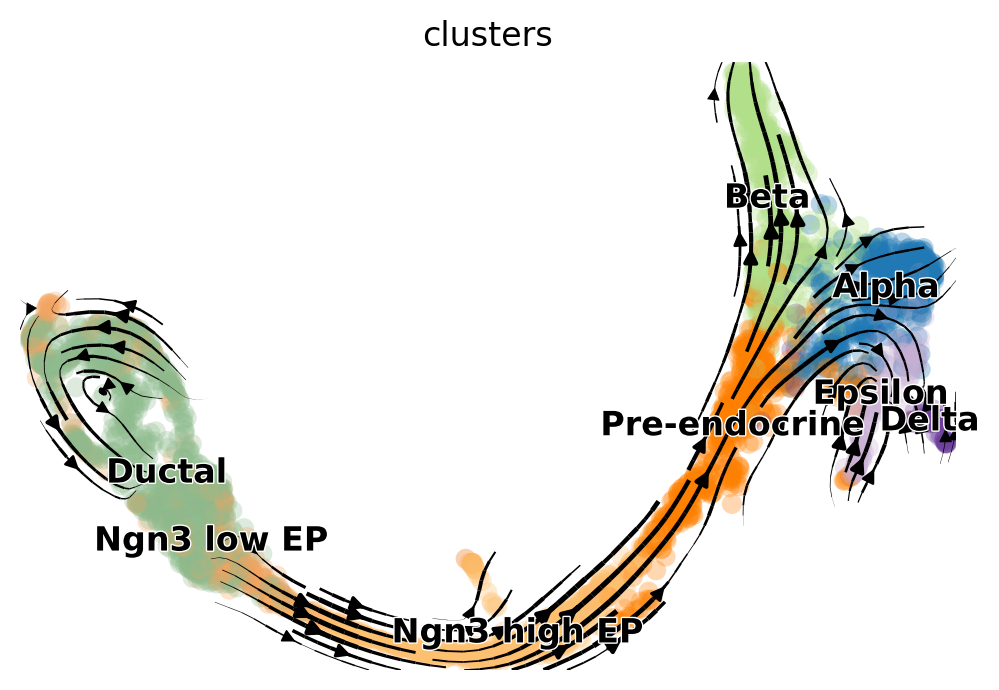

In [43]:
adata.obsm["X_new_umap"] = adata_umap
scv.pl.velocity_embedding_stream(adata, basis='new_umap', save="figure2_1")

In [47]:
#Heurstic scaling factor for the normalized magnitude when integrating
scaling_factor = np.percentile(Y.mean(axis=0) / X.mean(axis=0), 96)

#Heurstic maximum step size for the normalized magnitude when integrating
total_steps = int(np.percentile(np.abs(X.std(axis=0) * 2 / Y.mean(axis=0)), 90))
intermediate_step = 5
max_steps = total_steps // intermediate_step

print(scaling_factor, total_steps, max_steps)

0.6099452300286814 182 36


In [48]:
# ODE Solver Function
def raw_ae(t, in_x):
    input_x = tf.convert_to_tensor(np.expand_dims(in_x, axis=0))
    dx = autoencoder.predict(input_x).flatten() * scaling_factor
    return dx

# Interpolate over time
def interpolate(y0, neigh=neigh, pca=pca, umap_reducer=umap_reducer, steps=max_steps, intermediate_steps=intermediate_step):
    
    solution = []
    for step in range(steps):
        
        print(step)
        
        # Interpolate using autoencoder
        t_eval = list(range(intermediate_steps))
        #noise = np.random.normal(0, np.sqrt(adata.var["fit_variance"][adata.var["velocity_genes"]]), 
        #                          y0.shape[0])
        sol = solve_ivp(raw_ae, [0,max(t_eval)], y0, method="DOP853", t_eval=t_eval)
        y = sol.y.T
        
        # Lower dimensionality
        ending_pt_pca = pca.transform(np.nan_to_num(np.log1p(y)))
        ending_pt = umap_reducer.transform(ending_pt_pca)
        
        # Find knn reference points
        interp_neigh = neigh.kneighbors(ending_pt_pca)
        
        # New reference point
        y0 = np.median(X[interp_neigh[1][-1, :], :], axis=0)
        solution.append(y0)
        
        # Plot UMAP directions
        plt.figure(figsize=(10,3))
        plt.subplot(1, 3, 1)
        plt.scatter(adata_umap[:, 0], adata_umap[:, 1], 
                    s=1, alpha=0.5,
                    c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
        plt.scatter(ending_pt[:, 0], 
                    ending_pt[:, 1], 
                    c=np.arange(ending_pt.shape[0]), 
                    cmap="viridis",
                    s=20
                   )
        plt.colorbar()
        plt.scatter(ending_pt[0, 0], ending_pt[0, 1], s=20, color="red")
        plt.gca().set_aspect('equal', 'datalim')
        
        # Plot PCA directions
        plt.subplot(1, 3, 2)
        plt.scatter(adata_pca[:, 0], 
                    adata_pca[:, 1], 
                    s=1, 
                    alpha=0.5, 
                    c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
        plt.scatter(ending_pt_pca[:, 0], 
                    ending_pt_pca[:, 1], 
                    c=np.arange(ending_pt.shape[0]), 
                    cmap="viridis",
                    s=20
                   )
        plt.colorbar()
        plt.scatter(ending_pt_pca[0, 0], ending_pt_pca[0, 1], 
                    s=20, color="red")
        plt.gca().set_aspect('equal', 'datalim')

        plt.subplot(1, 3, 3)
        plt.scatter(adata_pca[:, 1], 
                    adata_pca[:, 2], 
                    s=1, 
                    alpha=0.5, c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
        plt.scatter(ending_pt_pca[:, 1], 
                    ending_pt_pca[:, 2], 
                    c=np.arange(ending_pt.shape[0]), 
                    cmap="viridis",
                    s=20
                   )
        plt.colorbar()
        plt.scatter(ending_pt_pca[0, 1], ending_pt_pca[0, 2], 
                    s=20, color="red")
        plt.gca().set_aspect('equal', 'datalim')
        plt.show()
    
    return np.array(solution)

0


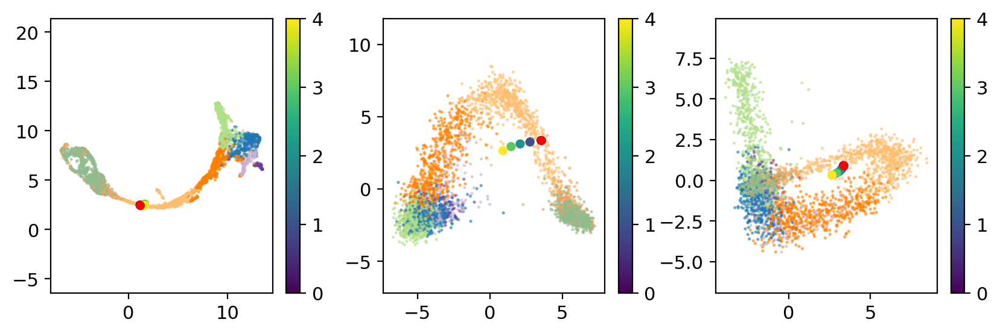

1


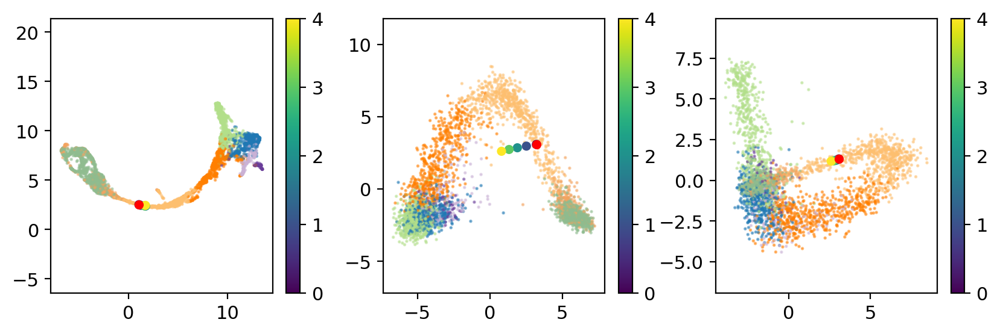

2


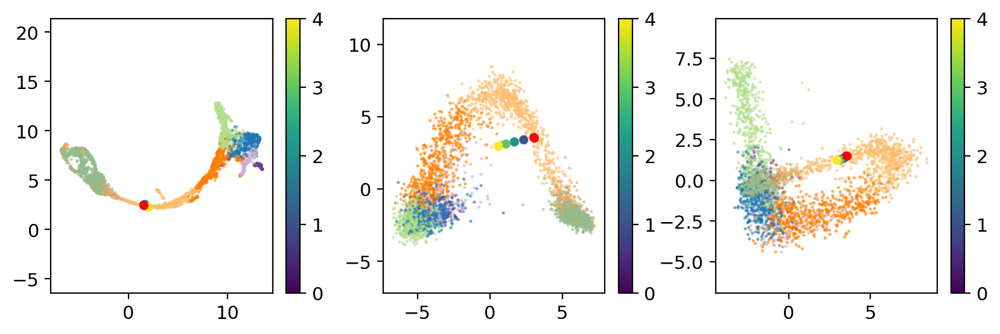

3


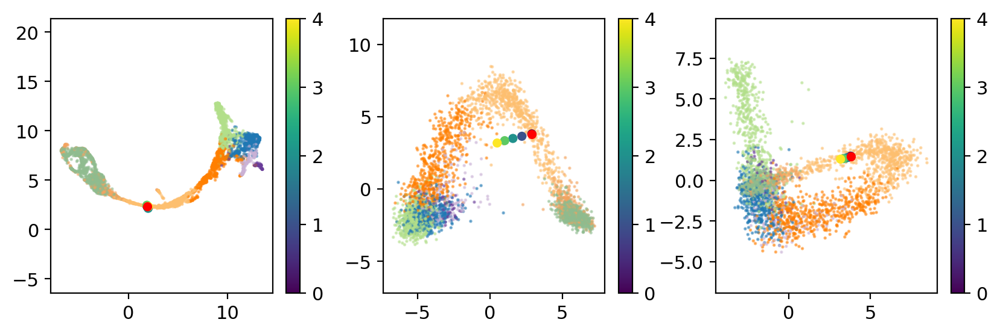

4


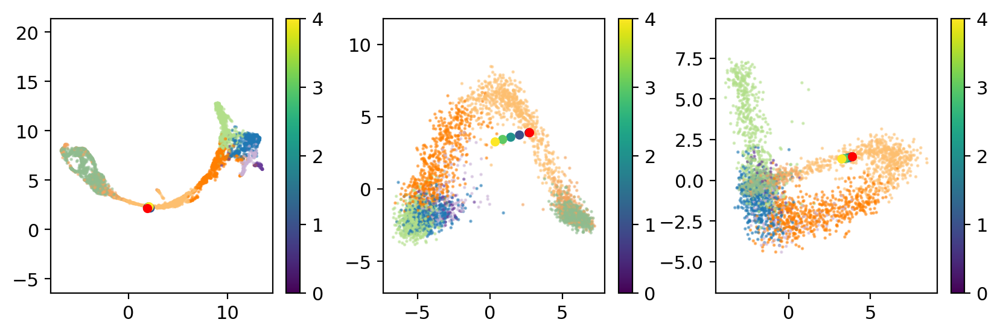

5


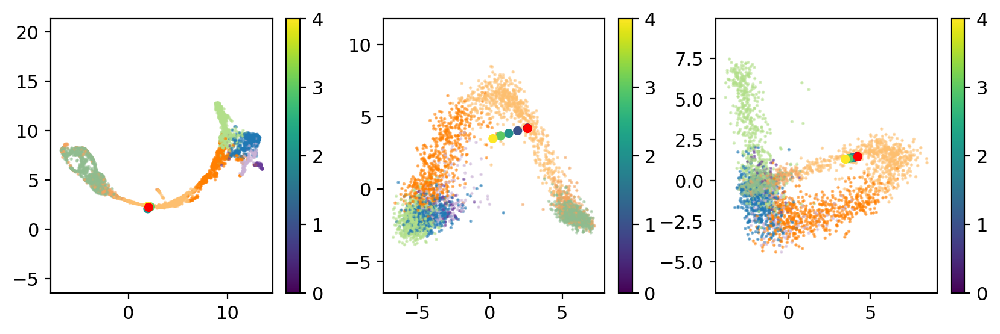

6


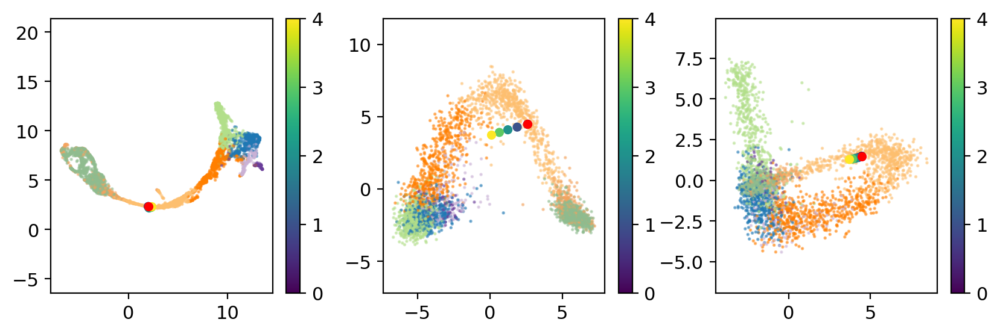

7


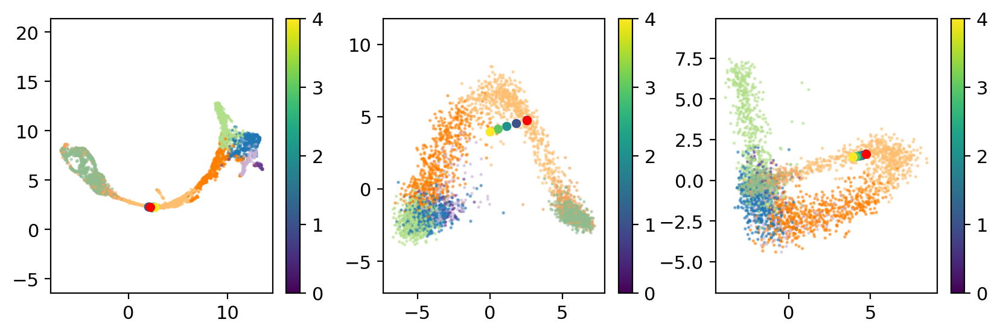

8


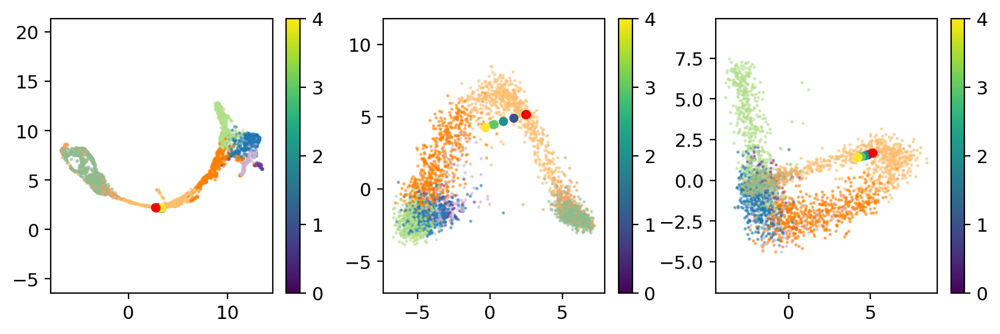

9


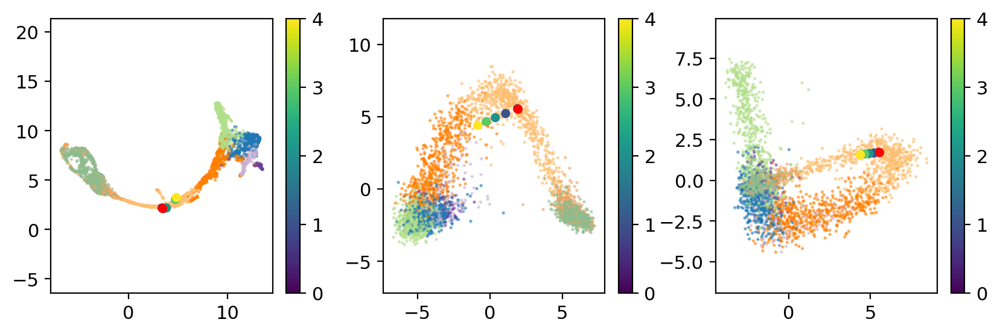

10


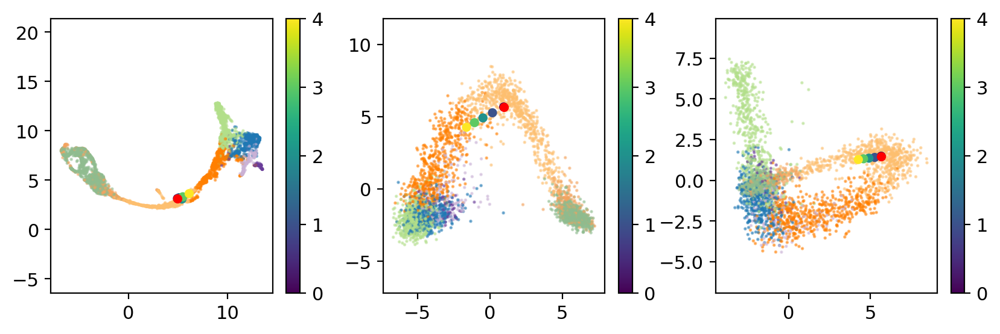

11


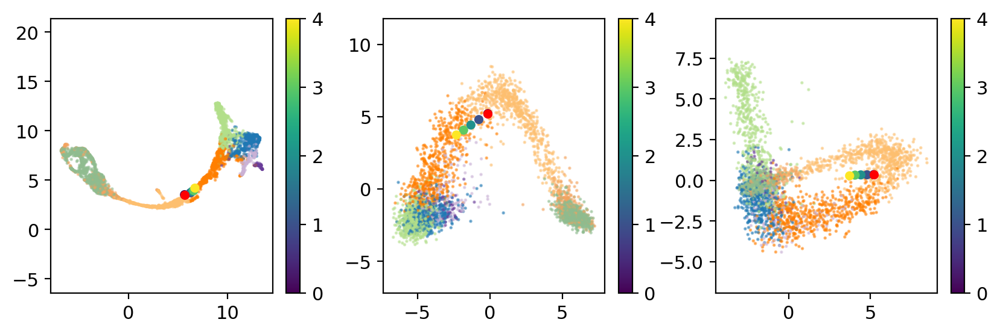

12


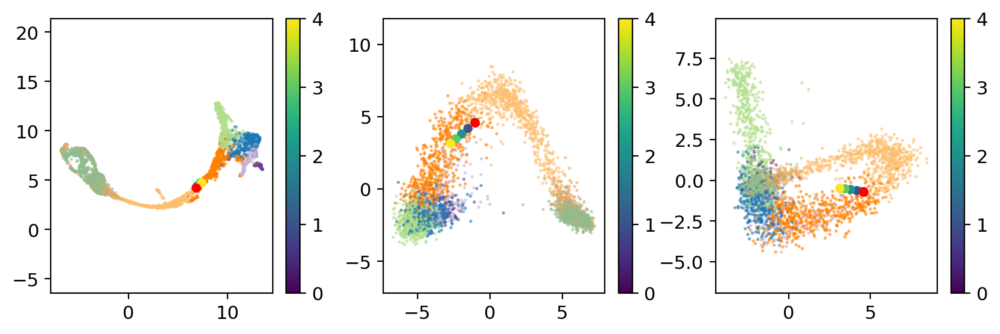

13


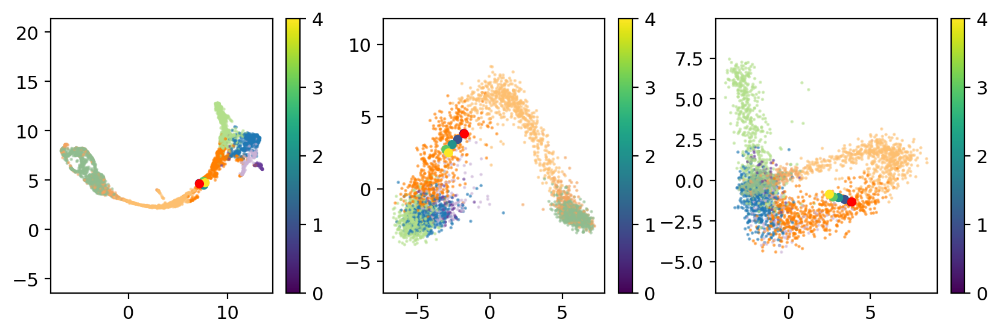

14


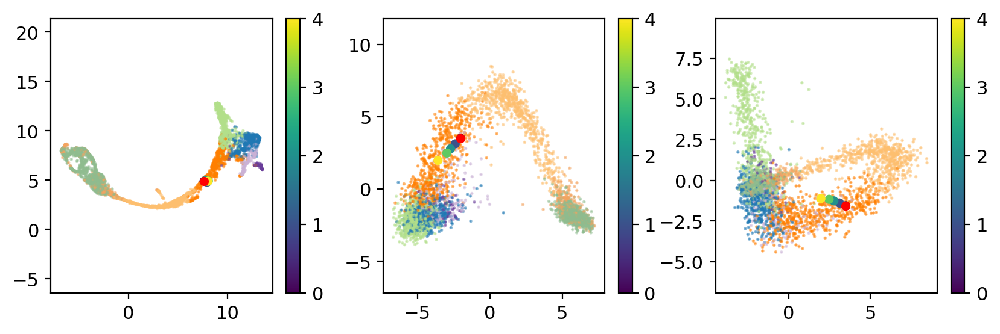

15


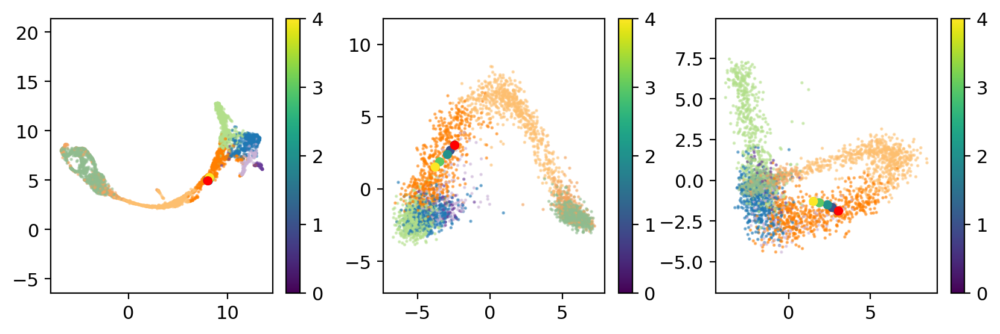

16


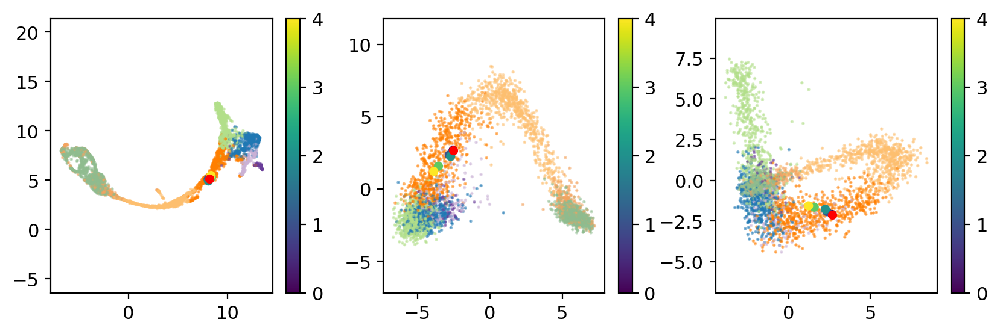

17


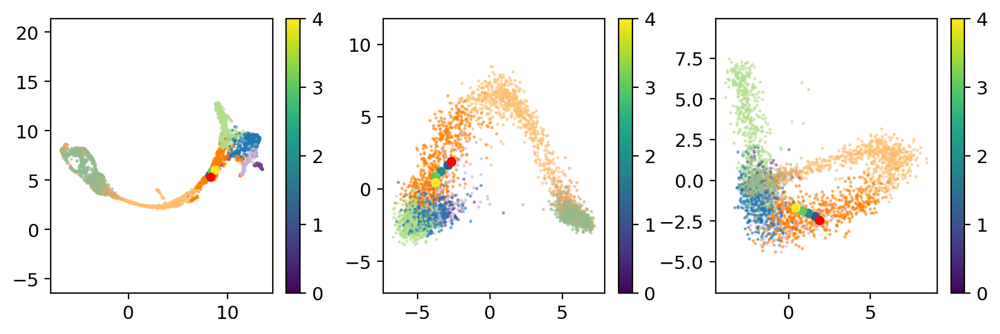

18


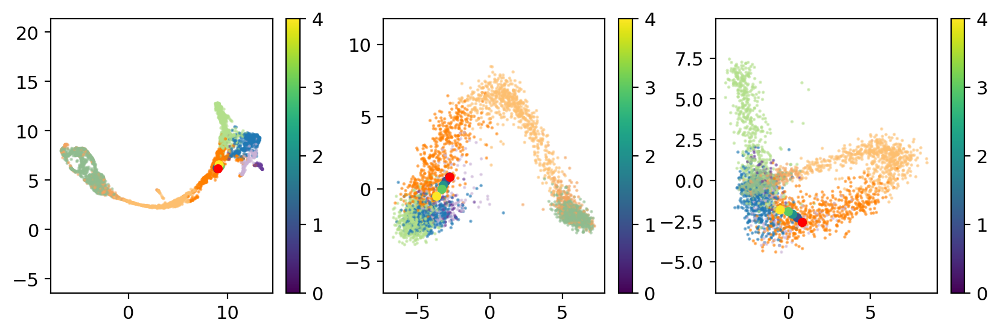

19


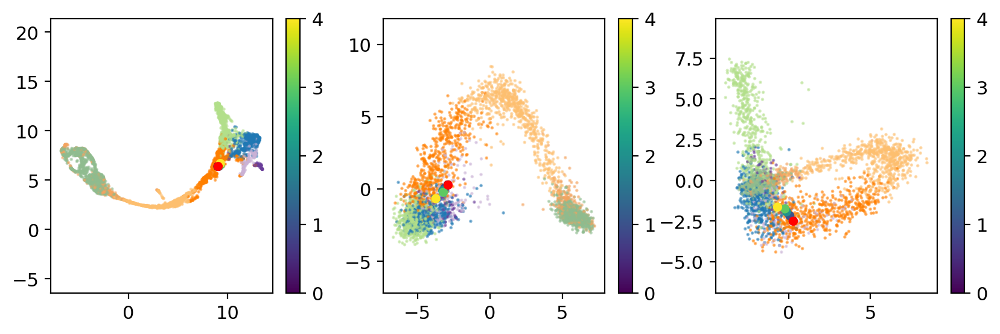

20


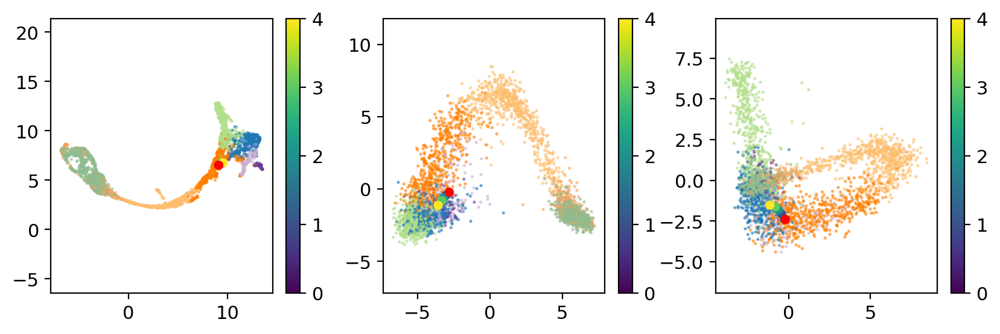

21


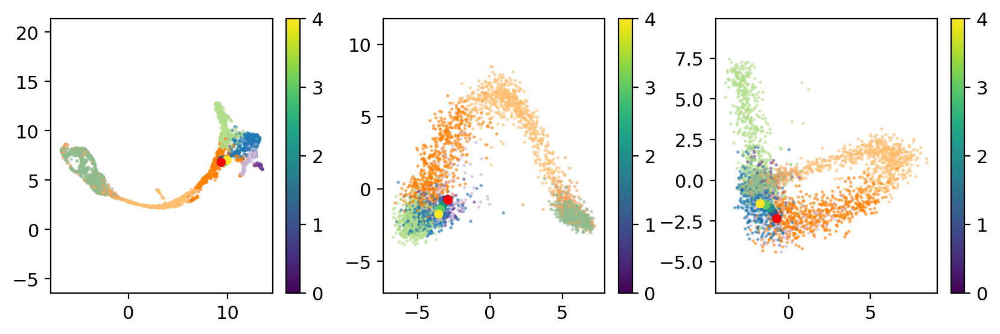

22


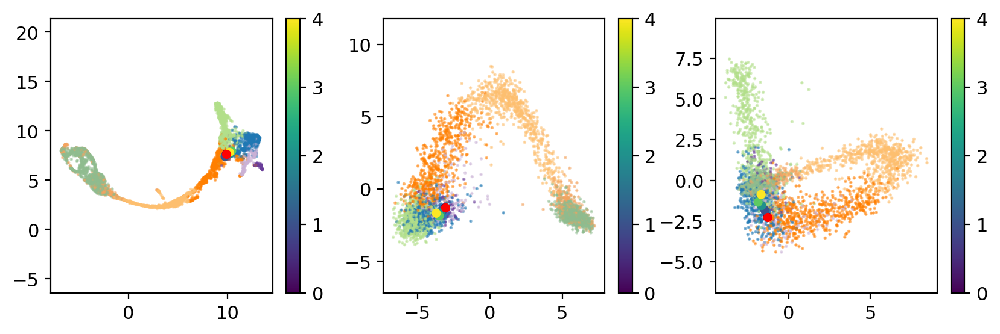

23


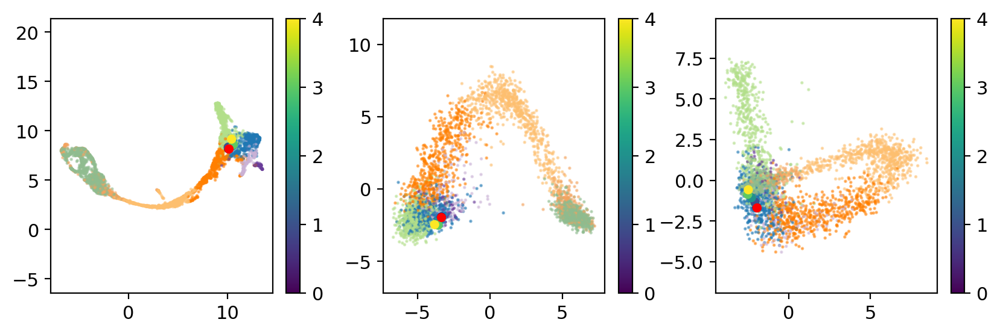

24


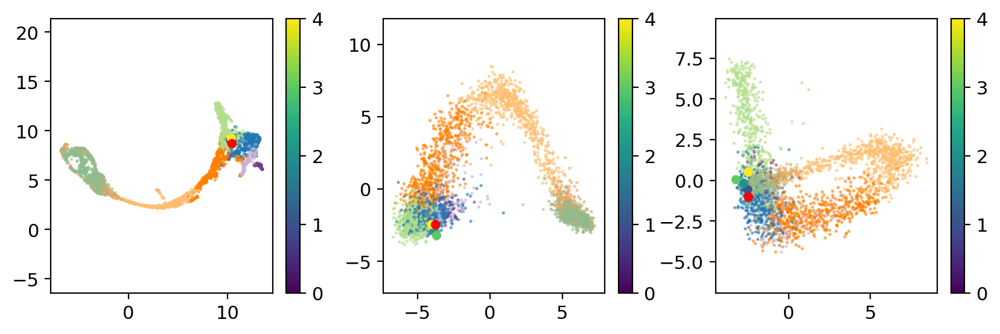

25


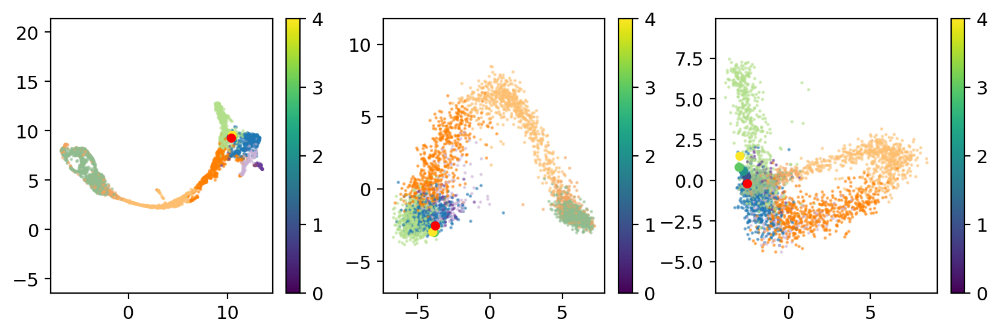

26


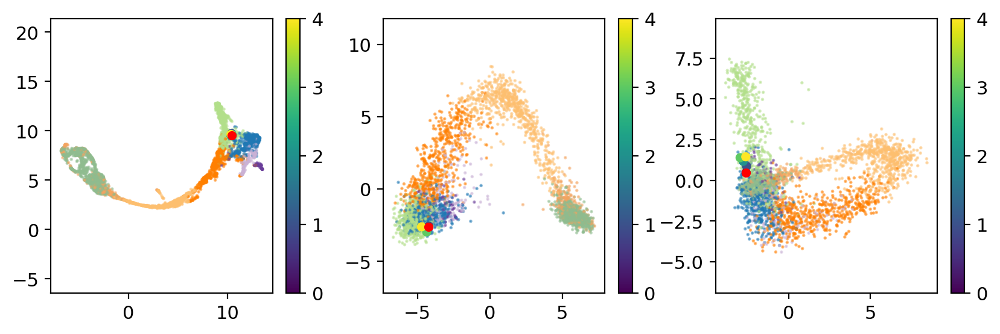

27


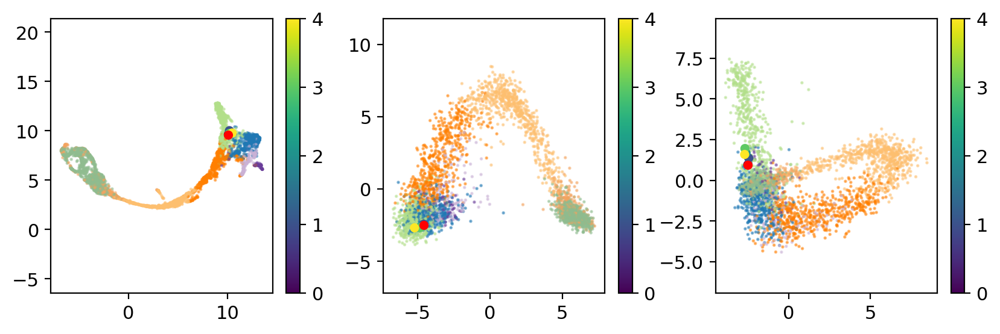

28


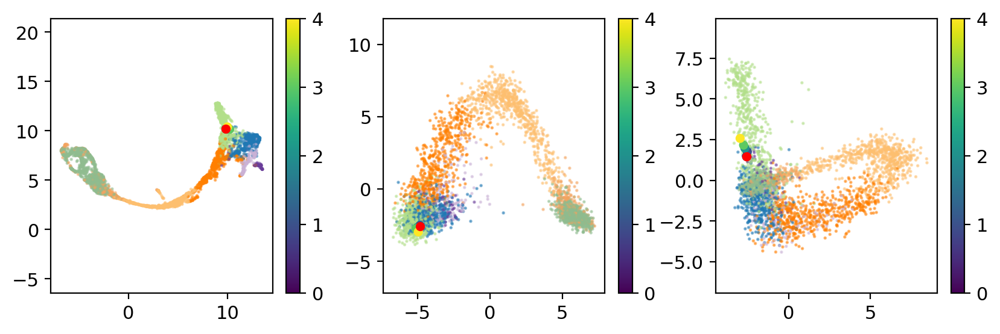

29


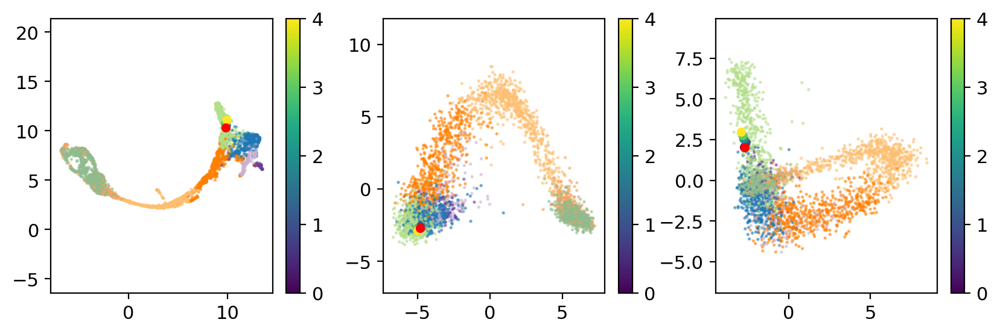

30


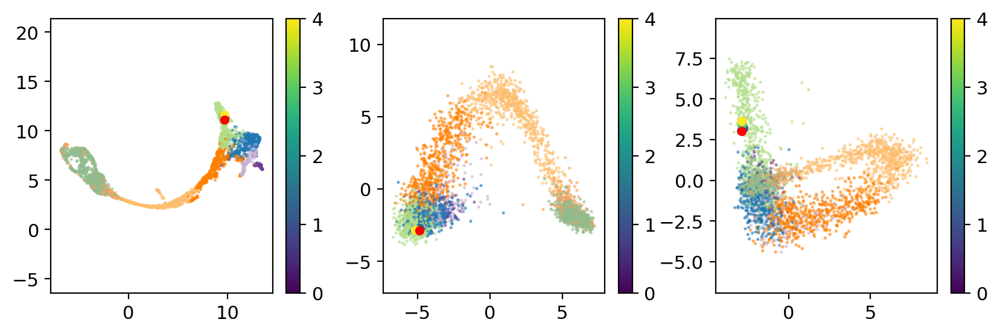

31


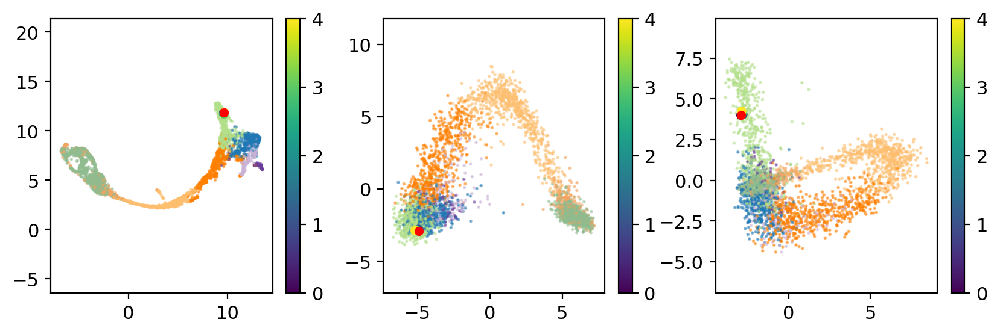

32


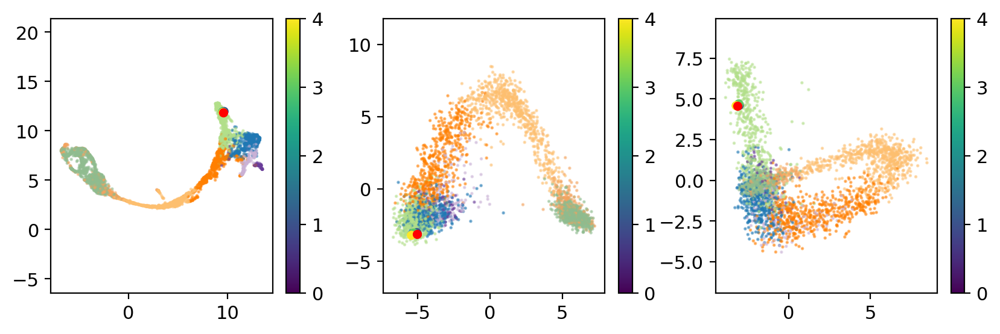

33


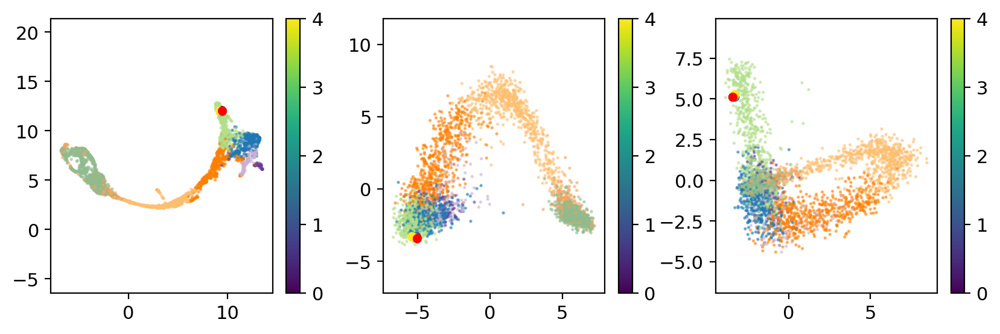

34


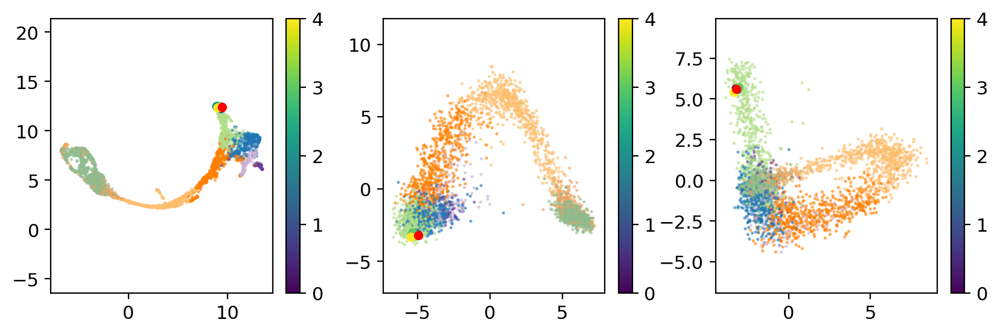

35


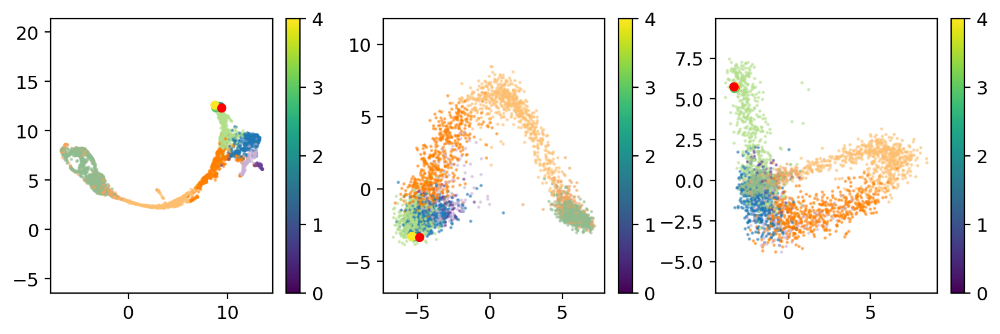

In [49]:
y0 = X[adata.shape[0] + np.where(adata.obs.clusters == "Ngn3 high EP")[0][32], :] 
y_solution = interpolate(y0, 
                         neigh = neigh, 
                         pca = pca, 
                         umap_reducer = umap_reducer, 
                         steps=max_steps)

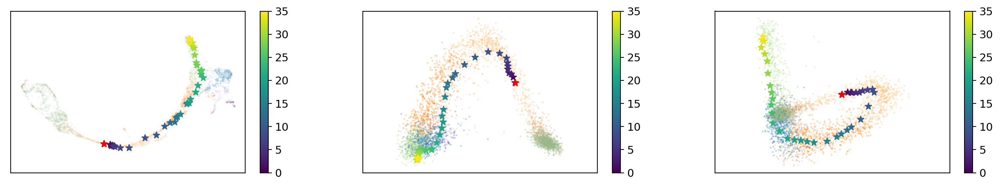

In [50]:
# Lower dimensionality
ending_pt_pca = pca.transform(np.nan_to_num(np.log1p(y_solution)))
ending_pt = umap_reducer.transform(ending_pt_pca)
        
# Plot UMAP directions
plt.figure(figsize=(18,3))
plt.subplot(1, 3, 1)
plt.scatter(adata_umap[:, 0], adata_umap[:, 1], 
            s=1, alpha=0.05,
            c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
plt.scatter(ending_pt[:, 0], 
            ending_pt[:, 1], 
            c=np.arange(ending_pt.shape[0]), 
            marker="*",
            cmap="viridis",
            s=45
           )
plt.colorbar()
plt.scatter(ending_pt[0, 0], 
            ending_pt[0, 1], 
            s=45, 
            marker="*", 
            color="red")
plt.gca().set_aspect('equal', 'datalim')
plt.xticks([]),plt.yticks([])

# Plot PCA directions
plt.subplot(1, 3, 2)
plt.scatter(adata_pca[:, 0], 
            adata_pca[:, 1], 
            s=1, 
            alpha=0.2, 
            c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
plt.scatter(ending_pt_pca[:, 0], 
            ending_pt_pca[:, 1], 
            c=np.arange(ending_pt.shape[0]), 
            marker="*",
            cmap="viridis",
            s=45
           )
plt.colorbar()
plt.scatter(ending_pt_pca[0, 0], 
            ending_pt_pca[0, 1], 
            s=45, 
            marker="*",
            color="red")
plt.gca().set_aspect('equal', 'datalim')
plt.xticks([]),plt.yticks([])

plt.subplot(1, 3, 3)
plt.scatter(adata_pca[:, 1], 
            adata_pca[:, 2], 
            s=1, 
            alpha=0.2, c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
plt.scatter(ending_pt_pca[:, 1], 
            ending_pt_pca[:, 2], 
            c=np.arange(ending_pt.shape[0]), 
            marker="*",
            cmap="viridis",
            s=45
           )
plt.colorbar()
plt.scatter(ending_pt_pca[0, 1], ending_pt_pca[0, 2], 
            s=45, marker="*", color="red")
plt.gca().set_aspect('equal', 'datalim')
plt.xticks([]),plt.yticks([])
plt.savefig("figures/figure2_2.pdf")
plt.show()

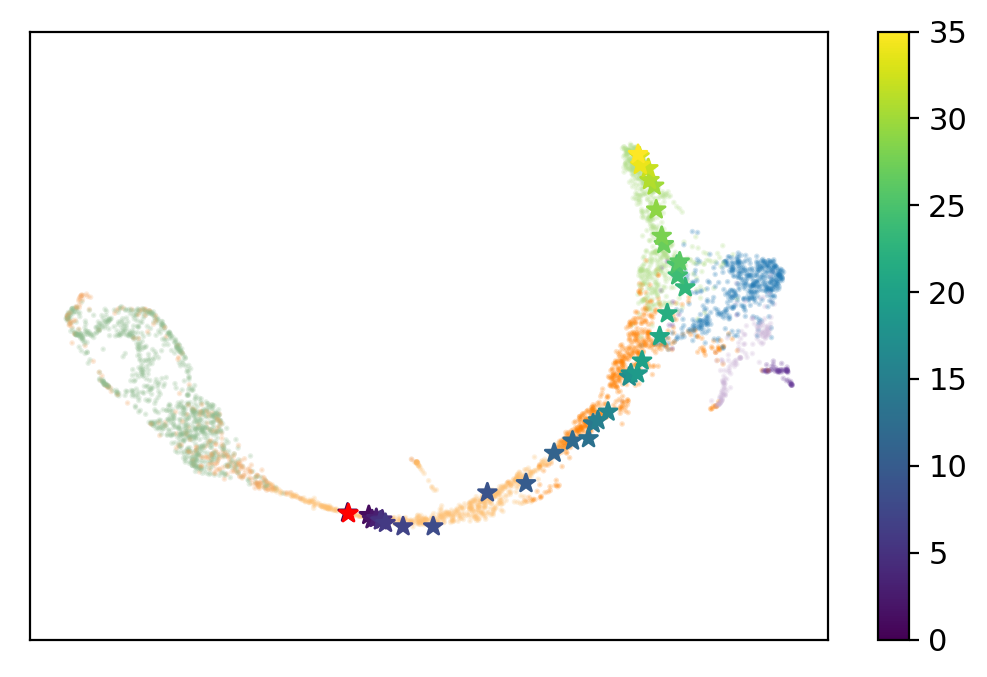

In [51]:
# Plot UMAP directions
plt.figure(figsize=(6.4, 4))
plt.scatter(adata_umap[:, 0], adata_umap[:, 1], 
            s=1, alpha=0.2,
            c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
plt.scatter(ending_pt[:, 0], 
            ending_pt[:, 1], 
            c=np.arange(ending_pt.shape[0]), 
            cmap="viridis",
            marker="*",
            s=45
           )
plt.colorbar()
plt.scatter(ending_pt[0, 0], ending_pt[0, 1], marker="*", s=45, color="red")
plt.gca().set_aspect('equal', 'datalim')
plt.xticks([]),plt.yticks([])
plt.savefig("figures/figure2_2_1.pdf")
plt.show()

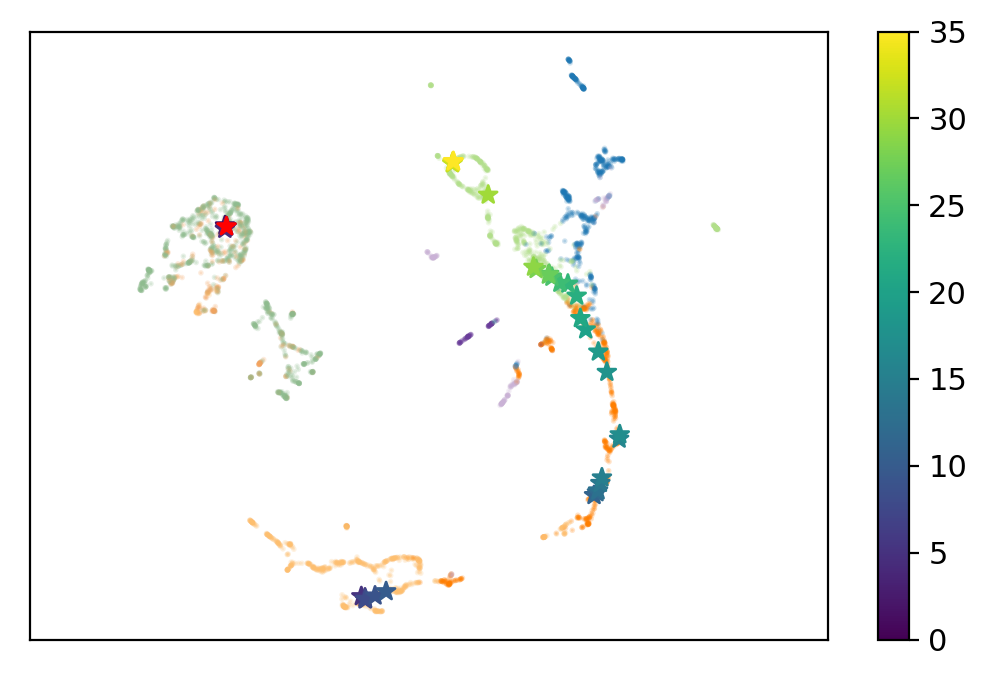

In [53]:
# PCA the count data
pca_velo = sklearn.decomposition.PCA(n_components=30)
adata_pca_velo = pca.fit_transform(np.nan_to_num(adata.layers["velocity"][:, adata.var["velocity_genes"]]))

# Further reduce the dim with UMAP
umap_reducer_velo = umap.UMAP(random_state=42, min_dist=0.25)
adata_umap_velo = umap_reducer.fit_transform(adata_pca_velo)

# Lower dimensionality
ending_pt_pca_velo = pca.transform(np.nan_to_num(autoencoder.predict(y_solution)))
ending_pt_velo = umap_reducer.transform(ending_pt_pca_velo)
        
# Plot UMAP directions
plt.figure(figsize=(6.4, 4))
plt.scatter(adata_umap_velo[:, 0], adata_umap_velo[:, 1], 
            s=1, alpha=0.2,
            c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()])
plt.scatter(ending_pt_velo[:, 0], 
            ending_pt_velo[:, 1], 
            c=np.arange(ending_pt.shape[0]), 
            cmap="viridis",
            marker="*",
            s=45
           )
plt.colorbar()
plt.scatter(ending_pt_velo[0, 0], ending_pt_velo[0, 1], marker="*", s=45, color="red")
plt.gca().set_aspect('equal', 'datalim')
plt.xticks([]),plt.yticks([])
plt.savefig("figures/figure2_2_2.pdf")
plt.show()

## Autoencoder Embeddings

In [54]:
encoder = keras.Model(autoencoder.input, autoencoder.get_layer(index = 2).output)
vae_embedding = encoder.predict(adata_raw.X.A[:, adata.var["velocity_genes"]])
vae_embedding_progress = encoder.predict(y_solution)

vae_reducer = umap.UMAP(random_state=42)
vae_embedding_umap = vae_reducer.fit_transform(vae_embedding)
vae_embedding_progress_umap = vae_reducer.transform(vae_embedding_progress)

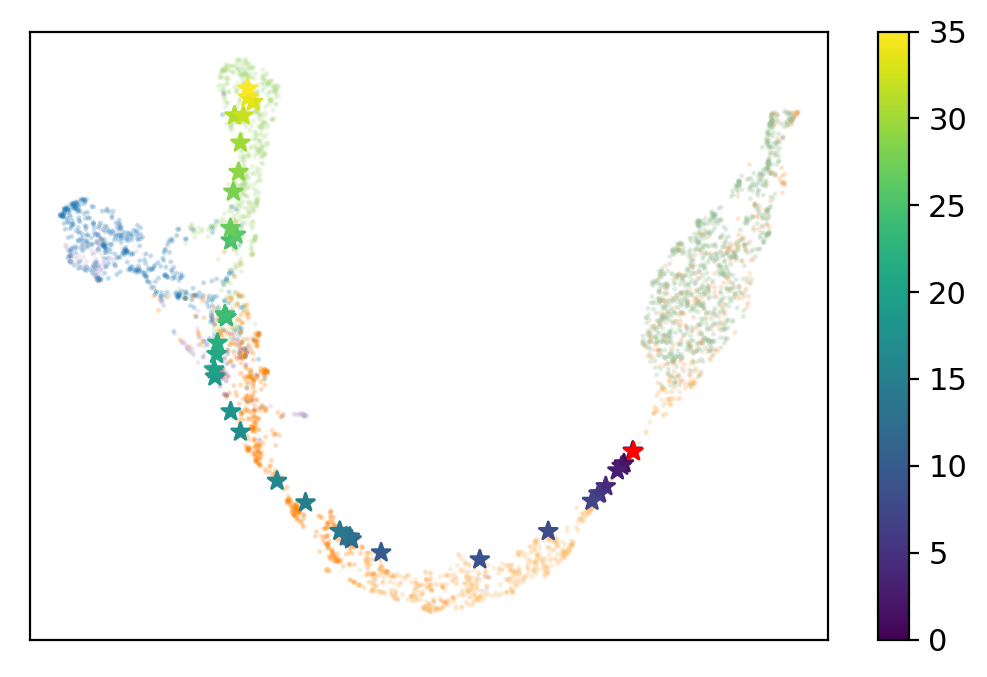

In [55]:
# Plot pancreas dataset
plt.figure(figsize=(6.4, 4))
plt.scatter(vae_embedding_umap[:, 0], 
            vae_embedding_umap[:, 1], 
            c=adata.uns["clusters_colors"][adata.obs.clusters.cat.codes.to_numpy()],
            s=1, 
            marker="*",
            alpha=0.22)
plt.scatter(vae_embedding_progress_umap[:, 0], 
            vae_embedding_progress_umap[:, 1], 
            c=np.arange(vae_embedding_progress_umap.shape[0]), 
            marker="*",
            cmap="viridis",
            s=45
           )
plt.colorbar()

# Plot simulated path
plt.scatter(vae_embedding_progress_umap[0, 0], 
            vae_embedding_progress_umap[0, 1], 
            s=45, 
            marker="*",
            color="red")
plt.gca().set_aspect('equal', 'datalim')
plt.xticks([]),plt.yticks([])
plt.savefig("figures/figure2_3.pdf")
plt.show()

## Cell Transformation Capacity

In [56]:
# Faster version of the previous function, using RK23 instead of DOP853
def fast_interpolate(y0, neigh=neigh, pca=pca, umap_reducer=umap_reducer, steps=max_steps, intermediate_steps=intermediate_step):
    
    solution = []
    for step in range(steps):
        
        # Interpolate using autoencoder
        t_eval = list(range(intermediate_steps))
        sol = solve_ivp(raw_ae, [0,max(t_eval)], y0, method="RK23", t_eval=t_eval)
        y = sol.y.T
        
        # Lower dimensionality
        ending_pt_pca = pca.transform(np.nan_to_num(np.log1p(y)))
        
        # Find knn reference points
        interp_neigh = neigh.kneighbors(ending_pt_pca)
        
        # New reference point
        y0 = np.median(X[interp_neigh[1][-1, :], :], axis=0)
        solution.append(y0)
    
    return np.array(solution)

In [ ]:
# Simulate trajectories for all cells in 30 time steps
all_paths = np.zeros((adata[:, adata.var["velocity_genes"]].shape[0], 
                      30, 
                      adata[:, adata.var["velocity_genes"]].shape[1]))
for i in range(adata.shape[0]):
    print(i)
    if (i % 50 == 0):
        with open('data/pancreas.all_paths.npy', 'wb') as f:
            np.save(f, all_paths)
    all_paths[i, :, :] = fast_interpolate(adata_raw.X[i, adata.var["velocity_genes"]].A.flatten(), 
                                     neigh = neigh, 
                                     pca = pca, 
                                     umap_reducer = umap_reducer)

with open('data/pancreas.all_paths.npy', 'wb') as f:
    np.save(f, all_paths)

In [57]:
all_paths = np.load('data/pancreas.all_paths.npy')

In [58]:
all_paths_relative_entropy = np.zeros(adata[:, adata.var["velocity_genes"]].shape[0])
for i in range(all_paths.shape[0]):
    for j in range(29):
        a = all_paths[i, j, :] / all_paths[i, j, :].sum()
        b = all_paths[i, j+1, :] / all_paths[i, j+1, :].sum()
        c = scipy.special.kl_div(a,b)
        c[c == np.inf] = 0
        all_paths_relative_entropy[i] += np.sum(c)
print(all_paths_relative_entropy)

[1.01247437 0.35090851 1.16557689 ... 0.1003865  0.66821468 1.12118174]


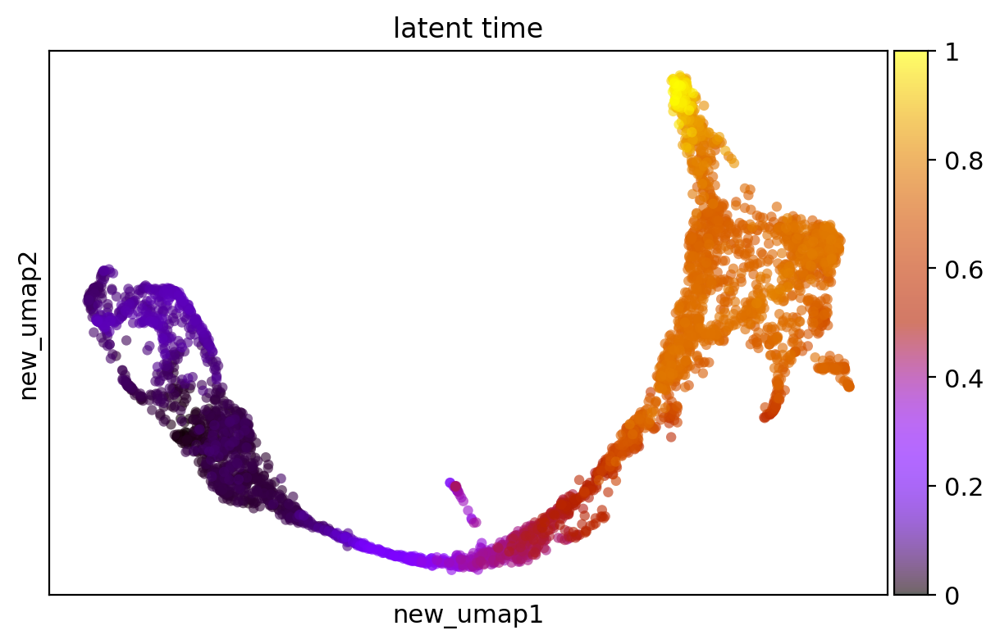

In [59]:
sc.pl.scatter(adata, color=['latent_time'], basis="new_umap", 
              color_map='gnuplot', size=80, save="figure2_4", alpha=0.6)

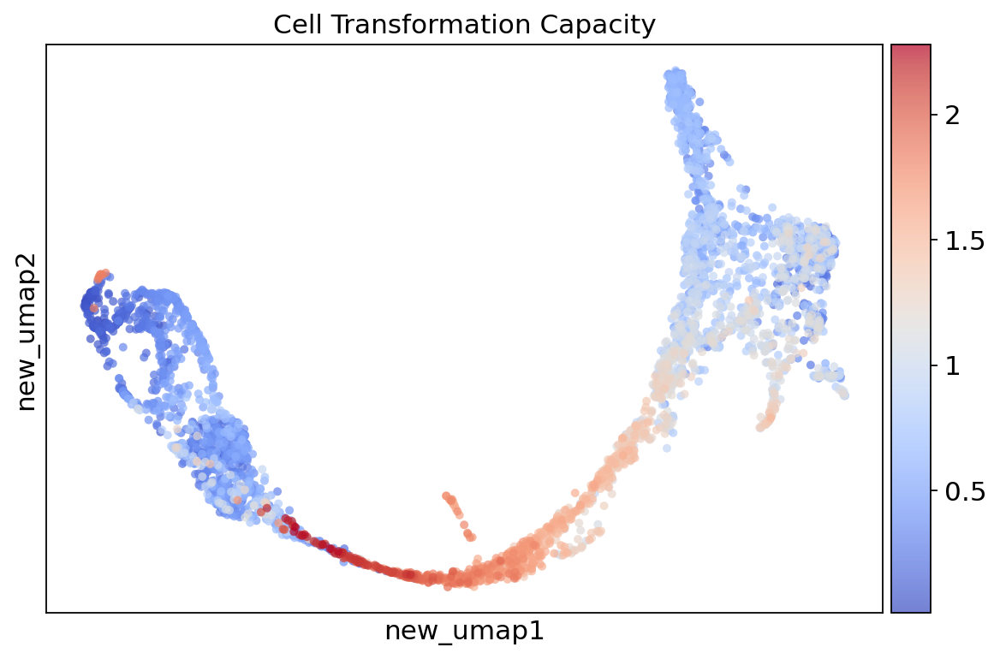

In [60]:
adata.obs["Cell Transformation Capacity"] = all_paths_relative_entropy
sc.set_figure_params(figsize=(7,5))
sc.pl.scatter(adata, color=["Cell Transformation Capacity"], 
              basis="new_umap", color_map="coolwarm", save="figure2_5", size=80, alpha=0.7)

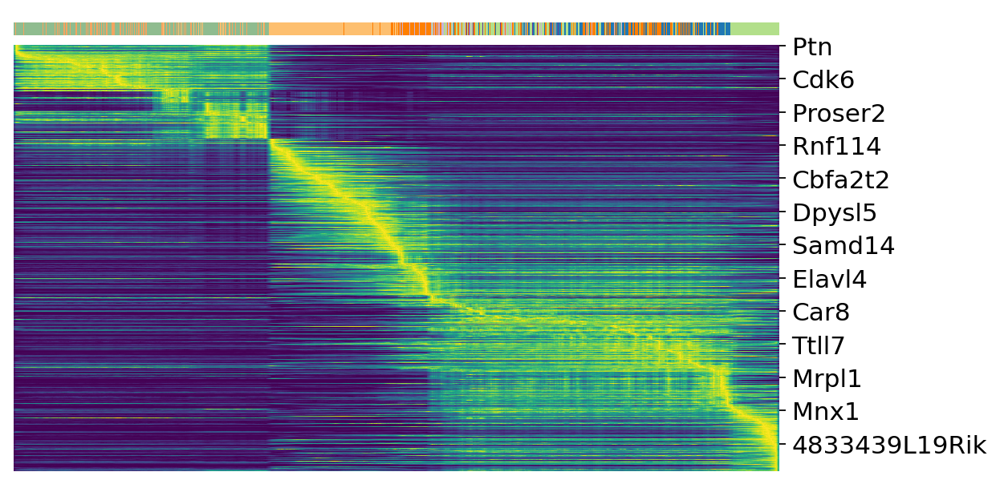

In [61]:
scv.pl.heatmap(adata, 
               adata.var.index[adata.var["velocity_genes"]], 
               sortby="latent_time",
               col_color="clusters",
              )      

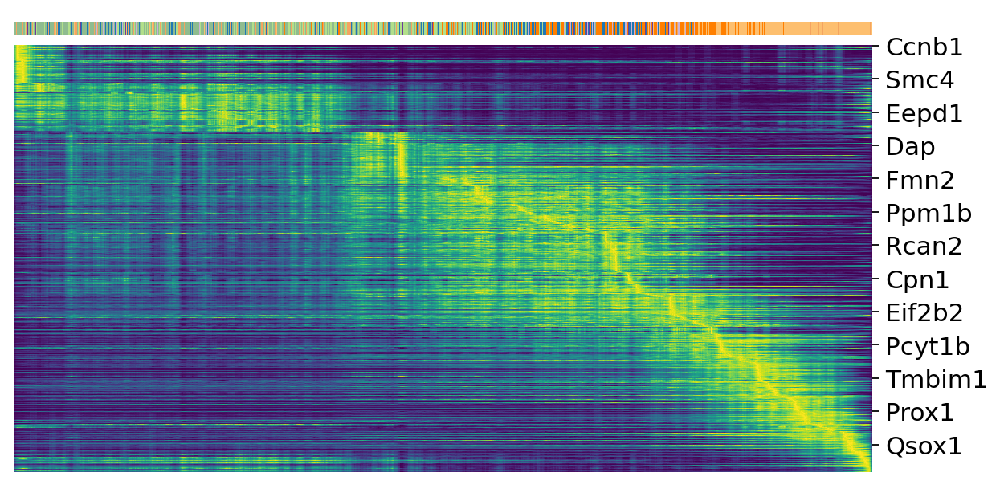

In [62]:
scv.pl.heatmap(adata, 
               adata.var.index[adata.var["velocity_genes"]], 
               sortby="Cell Transformation Capacity",
               col_color="clusters",
              )

In [63]:
adata.var["gene_ctc_corr"] = scv.utils.vcorrcoef(adata.X, adata.obs["Cell Transformation Capacity"].to_numpy())

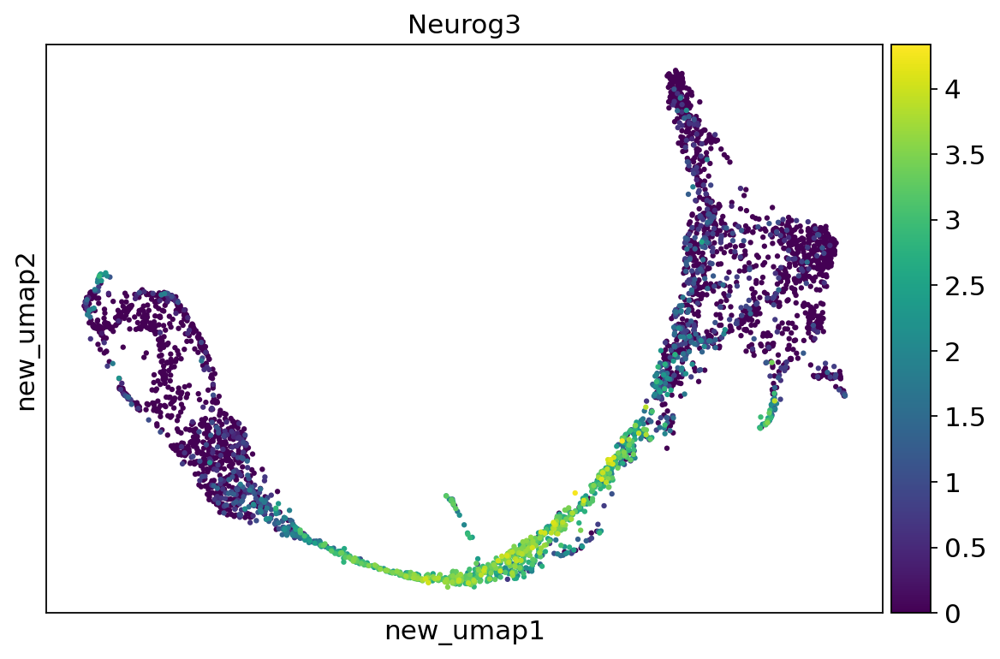

In [64]:
sc.pl.scatter(adata, 
              color=adata.var["gene_ctc_corr"].index[adata.var["gene_ctc_corr"].argsort()[-1]], 
              basis="new_umap",
              color_map="viridis")

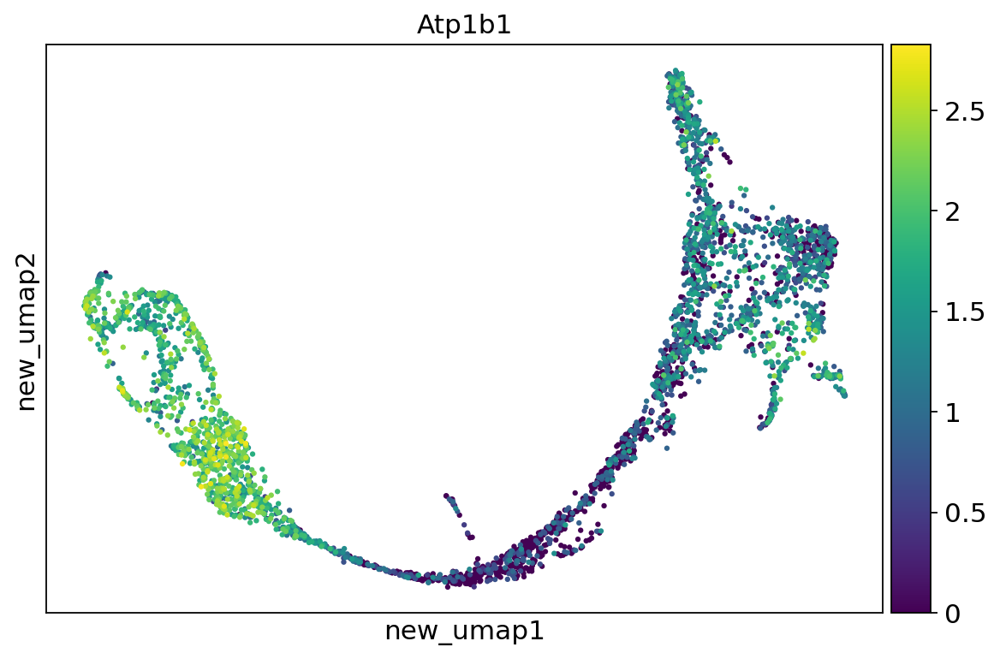

In [65]:
sc.pl.scatter(adata, 
              color=adata.var["gene_ctc_corr"].index[adata.var["gene_ctc_corr"].argsort()[0]], 
              basis="new_umap", 
              color_map="viridis")

## Retrograde Trajectories

In [66]:
# ODE Solver Function
def reverse_raw_ae(t, in_x):
    input_x = tf.convert_to_tensor(np.expand_dims(in_x, axis=0))
    dx = autoencoder.predict(input_x).flatten() * -scaling_factor
    return dx

# Interpolate over time
def short_reverse_interpolate(y0, neigh=neigh, pca=pca, umap_reducer=umap_reducer, steps=15, intermediate_steps=intermediate_step):
    
    solution = []
    for step in range(steps):
        
        # Interpolate using autoencoder
        t_eval = list(range(intermediate_steps))
        noise = np.random.normal(0, np.sqrt(adata.var["fit_variance"][adata.var["velocity_genes"]]) * 2, 
                                  y0.shape[0])
        sol = solve_ivp(reverse_raw_ae, [min(t_eval), max(t_eval)], y0+noise, method="RK23", t_eval=t_eval)
        y = sol.y.T
        
        # Lower dimensionality
        ending_pt_pca = pca.transform(np.nan_to_num(np.log1p(y)))
        
        # Find knn reference points
        interp_neigh = neigh.kneighbors(ending_pt_pca)
        
        # New reference point
        y0 = np.median(X[interp_neigh[1][-1, :], :], axis=0)
        solution.append(y0)
    
    return np.array(solution)

In [ ]:
n_iter = 200
cell_path = np.zeros((n_iter, 15, X.shape[1]))
terminal_cell_types = ["Alpha", "Beta", "Delta", "Epsilon"]
for i in range(n_iter):
    
    y0 = np.median(adata_raw.X[np.ix_(np.where(adata.obs.clusters == terminal_cell_types[i // 50])[0], 
                                       adata.var["velocity_genes"])].A, 
                   axis=0)
    y0_var = adata_raw.X[np.ix_(np.where(adata.obs.clusters == terminal_cell_types[i // 50])[0], 
                                       adata.var["velocity_genes"])].A.var(axis=0)
    
    if i % 20 == 0:
        print(i, terminal_cell_types[i // 50])
        with open('data/pancreas.terminal_cells_path_reverse.npy', 'wb') as f:
            np.save(f, cell_path)
    
    # Solve for the cell with initial & velocity noise
    y0_noise = np.random.laplace(0, np.sqrt(y0_var/2), y0.shape[0])
    y_solution = short_reverse_interpolate(y0+y0_noise, neigh = neigh, pca = pca, umap_reducer = umap_reducer)
    cell_path[i] = y_solution

In [67]:
all_cell_path_np = adata.X.A[np.ix_(np.argsort(adata.obs.latent_time).to_numpy(), 
               np.where(adata.var["velocity_genes"])[0])]
all_cell_path = pd.DataFrame(data=all_cell_path_np,
                             columns=adata.var.index[adata.var["velocity_genes"]],
                             index=adata.obs.clusters.to_numpy())
all_cell_path = all_cell_path[all_cell_path.index == "Beta"]

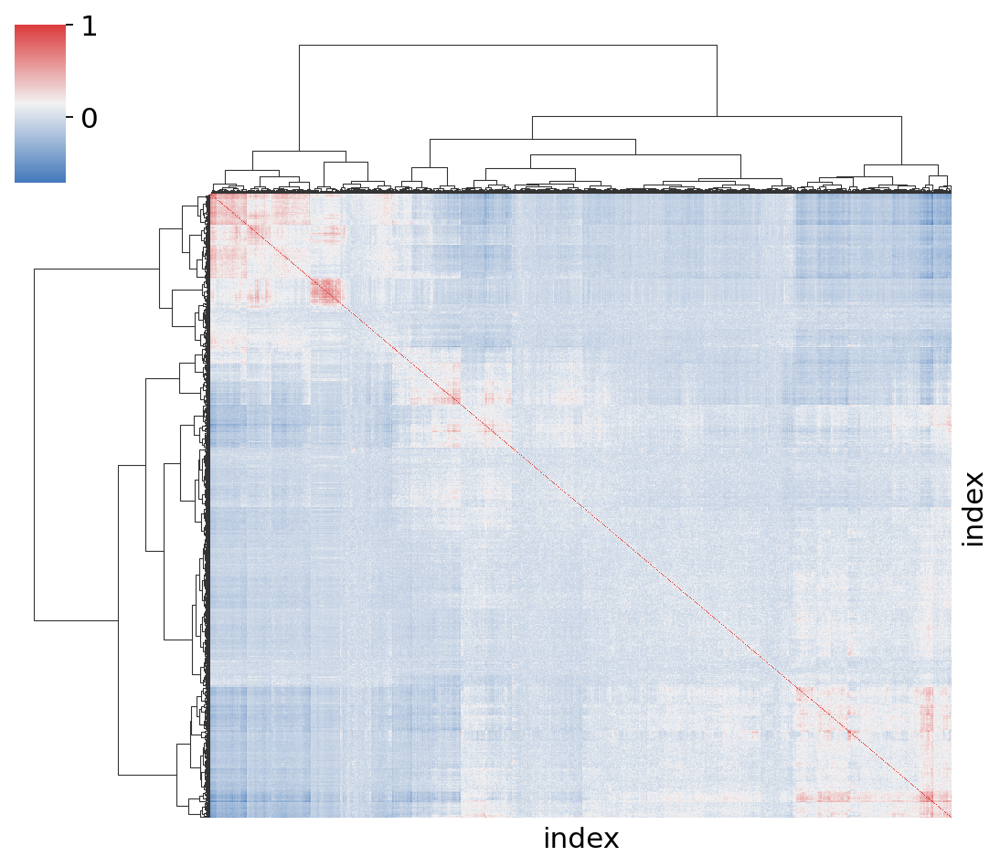

In [68]:
from scipy.cluster.hierarchy import linkage, fcluster

# calculate the correlation matrix
corr = all_cell_path.corr(method='pearson').fillna(0)
corr = corr.loc[:, (corr != 0).any(axis=0)]
corr = corr.loc[(corr != 0).any(axis=1), :]

row_linkage = linkage(corr, method='ward', optimal_ordering=True)

# plot the heatmap
sns.clustermap(corr, figsize=(7,6), xticklabels=False, yticklabels=False, 
               row_linkage = row_linkage, col_linkage = row_linkage,
               cmap=sns.diverging_palette(250, 12, as_cmap=True))

(609, 609)
(627, 627)
(595, 595)
(562, 562)


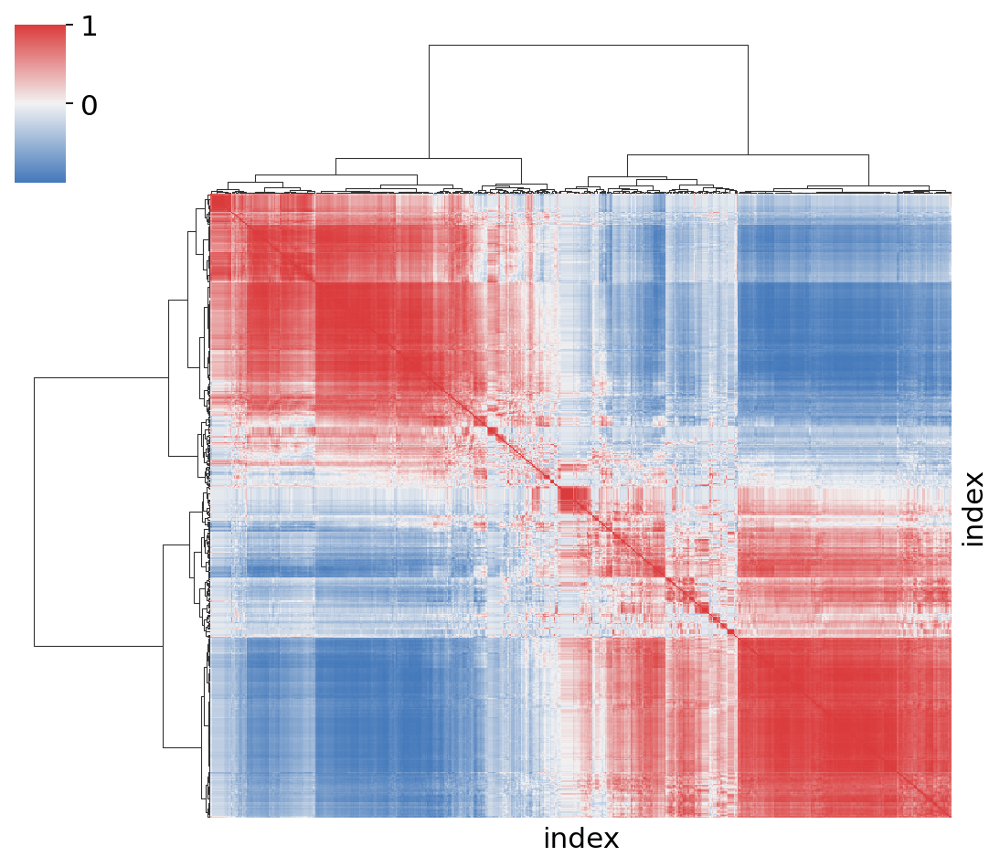

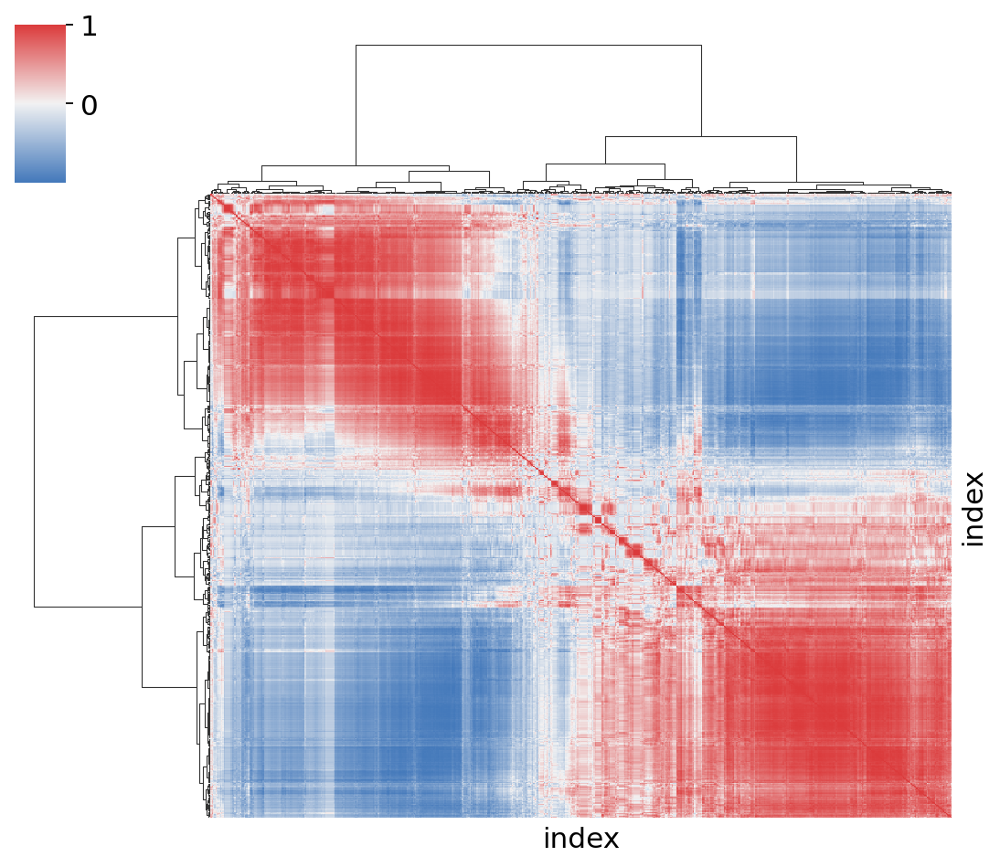

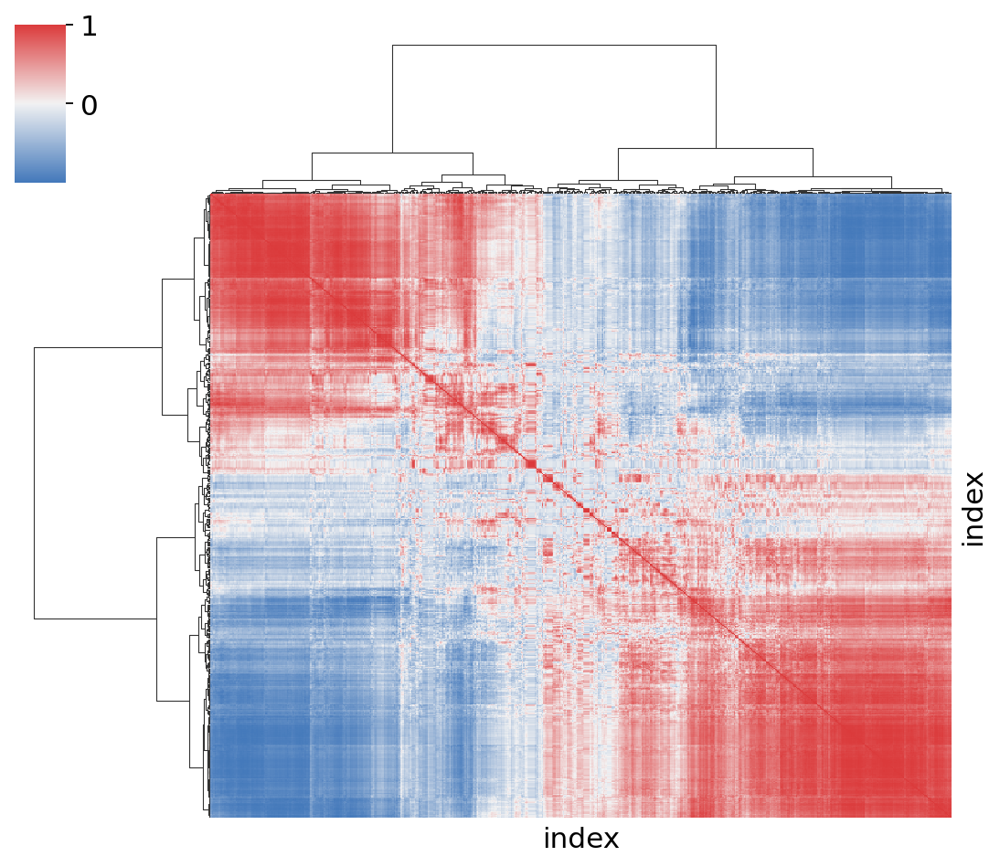

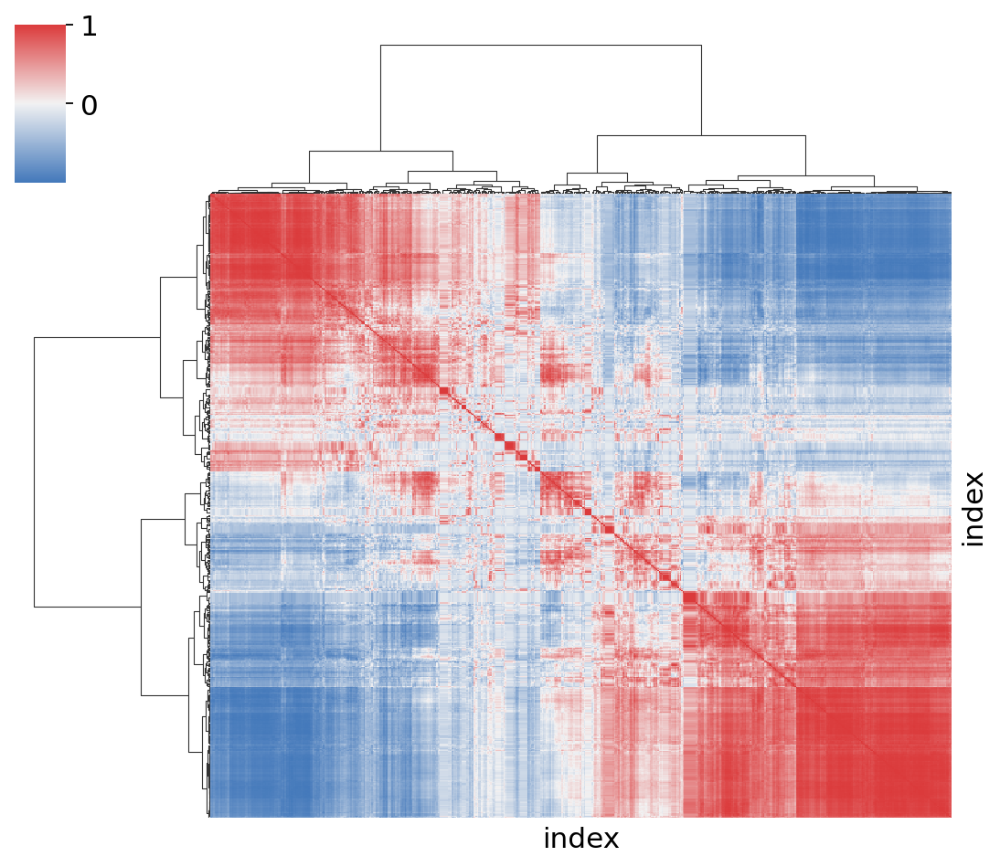

In [69]:
from scipy.cluster.hierarchy import linkage, fcluster
import matplotlib.pyplot as plt
cell_path = np.load('data/pancreas.terminal_cells_path_reverse.npy')
terminal_cell_types = ["Alpha", "Beta", "Delta", "Epsilon"]
for i in list(range(0, 200, 50)):
    cell_type_path = np.swapaxes(cell_path[i:(i+50)], 0, 1).mean(axis=1)
    cell_type_path = pd.DataFrame(data=cell_type_path,
                 columns=adata.var.index[adata.var["velocity_genes"]],
                 index=list(range(cell_type_path.shape[0])))
    
    # calculate the correlation matrix
    corr_original = cell_type_path.corr(method='pearson').fillna(0)
    corr = corr_original.loc[:, (corr_original != 0).any(axis=0)]
    corr = corr.loc[(corr != 0).any(axis=1), :]
    
    row_linkage = linkage(corr, method='ward', optimal_ordering=True)

    # plot the heatmap
    sns.clustermap(corr, figsize=(7,6), row_linkage=row_linkage, col_linkage = row_linkage, 
                   xticklabels=False, yticklabels=False, cmap=sns.diverging_palette(250, 12, as_cmap=True))
    #plt.savefig('gene-correlation-overtime.' + terminal_cell_types[i // 50] + '.pdf', dpi=300)
    #plt.savefig('gene-correlation-overtime.' + terminal_cell_types[i // 50] + '.png', dpi=300)
    #plt.savefig('gene-correlation-overtime.' + terminal_cell_types[i // 50] + '.svg', dpi=300)
    print(corr.shape)
    
    #output 3 gene clusters
    gene_cluster_list = []
    gene_clusters = fcluster(row_linkage, 3, criterion='maxclust')
    for j in np.unique(gene_clusters):
        cluster_idx = np.where(j == gene_clusters)[0]
        gene_name = adata.var.index[adata.var["velocity_genes"]][(corr_original != 0).any(axis=0)][cluster_idx].to_list()
        gene_cluster_list.append(gene_name)

    with open('gene_clusters/' + terminal_cell_types[i // 50] + '.pickle', 'wb') as handle:
        pickle.dump(gene_cluster_list, handle, protocol=pickle.HIGHEST_PROTOCOL)

## Perturbation Studies

In [ ]:
# Interpolate over time
def short_interpolate(y0, neigh=neigh, pca=pca, umap_reducer=umap_reducer, steps=15, intermediate_steps=intermediate_step):
    
    solution = []
    for step in range(steps):
        
        # Interpolate using autoencoder
        t_eval = list(range(intermediate_steps))
        noise = np.random.normal(0, adata.var["fit_variance"][adata.var["velocity_genes"]], 
                                  y0.shape[0])
        sol = solve_ivp(raw_ae, [0,max(t_eval)], y0+noise, method="RK23", t_eval=t_eval)
        y = sol.y.T
        
        # Lower dimensionality
        ending_pt_pca = pca.transform(np.nan_to_num(np.log1p(y)))
        
        # Find knn reference points
        interp_neigh = neigh.kneighbors(ending_pt_pca)
        
        # New reference point
        y0 = np.median(X[interp_neigh[1][-1, :], :], axis=0)
        solution.append(y0)
    
    return np.array(solution)

### Baseline

In [ ]:
n_iter = 1000
starting_cells = np.zeros((n_iter, X.shape[1]))
terminal_cells = np.zeros((n_iter, X.shape[1]))
y0 = np.median(adata_raw.X[np.ix_(np.where(adata.obs.clusters == "Pre-endocrine")[0], 
                                   adata.var["velocity_genes"])].A, 
               axis=0)
y0_var = adata_raw.X[:, adata.var["velocity_genes"]].A.var(axis=0)
for i in range(n_iter):
    
    if (i % 50 == 0):
        print(i)
        with open('data/pancreas.terminal_cells.npy', 'wb') as f:
            np.save(f, np.vstack([starting_cells, terminal_cells]))
    
    # Solve for the cell with initial & velocity noise
    y0_noise = np.random.laplace(0, np.sqrt(y0_var/2), y0.shape[0])
    y_solution = short_interpolate(y0+y0_noise, neigh = neigh, pca = pca, umap_reducer = umap_reducer)
    starting_cells[i] = y_solution[0, :]
    terminal_cells[i] = y_solution[-1, :]
    
with open('data/pancreas.terminal_cells.npy', 'wb') as f:
    np.save(f, np.vstack([starting_cells, terminal_cells]))

In [72]:
starting_cells = np.load('data/pancreas.terminal_cells.npy')[:1000]
terminal_cells = np.load('data/pancreas.terminal_cells.npy')[1000:]

In [14]:
KNClass = sklearn.neighbors.KNeighborsClassifier(n_neighbors=30)
KNClass.fit(adata_pca, adata_raw.obs.clusters)
terminal_pca = pca.transform(np.nan_to_num(np.log1p(terminal_cells)))
terminal_class = KNClass.predict(terminal_pca)
terminal_probs = KNClass.predict_proba(terminal_pca)
print(np.sum(terminal_class == "Alpha") / terminal_class.shape[0])

0.103


... storing 'KNN_labels' as categorical


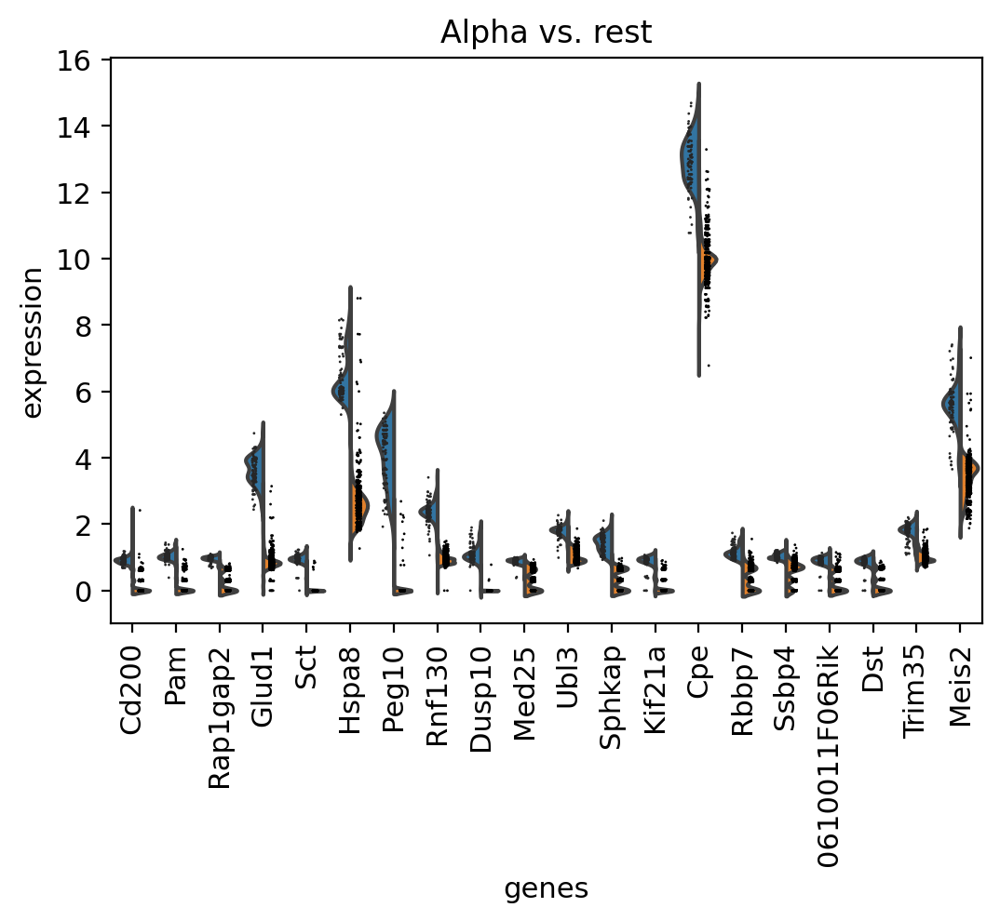

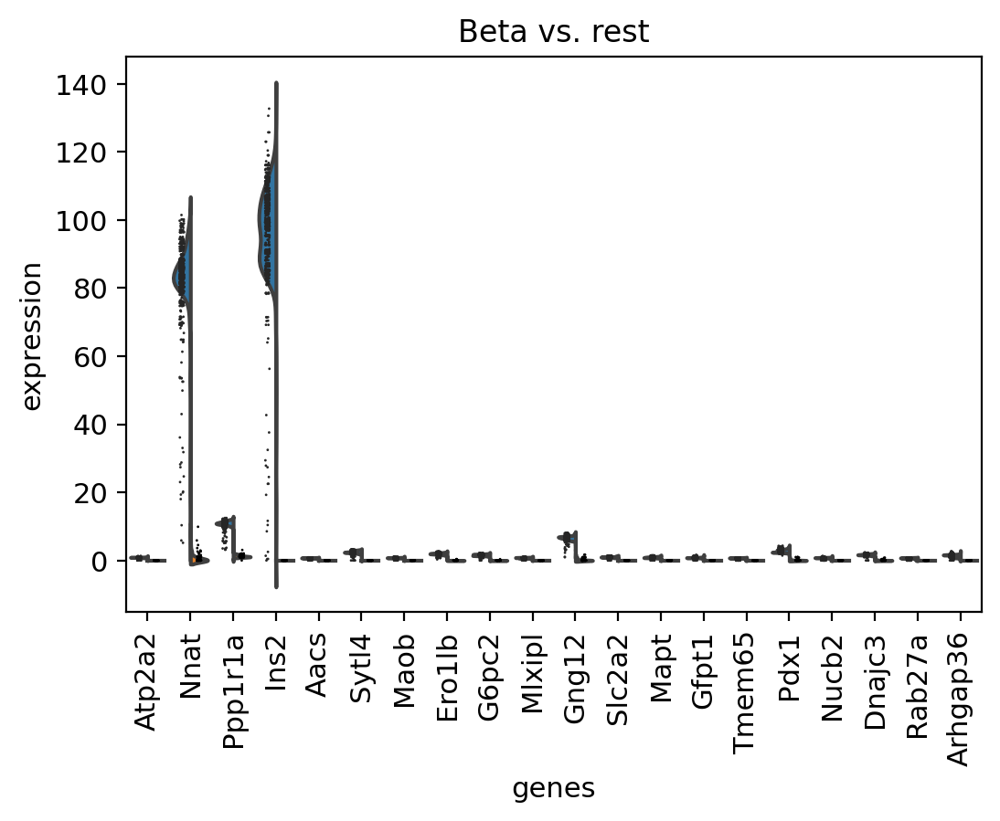

In [19]:
import anndata as ad
terminal_adata = ad.AnnData(starting_cells, 
                            var=adata[:, adata.var["velocity_genes"]].var)
terminal_adata.obs["KNN_labels"] = terminal_class
sc.tl.rank_genes_groups(terminal_adata, 'KNN_labels', groups=["Alpha", "Beta"])
sc.pl.rank_genes_groups_violin(terminal_adata)

### Perturbation Experiment to Increase Alpha Cell Percentage

In [54]:
top_100_alpha_genes = [i[0] for i in terminal_adata.uns["rank_genes_groups"]["names"][:100]]
top_100_alpha_genes_idx = [np.where(i == adata_raw.var.index[adata.var["velocity_genes"]])[0][0] for i in top_100_alpha_genes]
top_100_alpha_genes_idx = np.unique(np.sort(top_100_alpha_genes_idx))

In [55]:
n_iter = 1000
starting_cells_perturb = np.zeros((n_iter, X.shape[1]))
terminal_cells_perturb = np.zeros((n_iter, X.shape[1]))
y0 = np.median(adata_raw.X[np.ix_(np.where(adata.obs.clusters == "Pre-endocrine")[0], 
                                   adata.var["velocity_genes"])].A, 
               axis=0)
y0_sigma = adata_raw.X[:, np.where(adata.var["velocity_genes"])[0][top_100_alpha_genes_idx]].A.std(axis=0)
for i in range(n_iter):
    
    if (i % 50 == 0):
        print(i)
        with open('terminal_cells_perturb.npy', 'wb') as f:
            np.save(f, np.vstack([starting_cells_perturb, terminal_cells_perturb]))
    
    # Solve for the cell with initial & velocity noise
    y0_noise = np.zeros(y0.shape[0])
    y0_noise[top_100_alpha_genes_idx] += np.random.exponential(y0_sigma)
    y_solution = interpolate(y0+y0_noise, neigh = neigh, pca = pca, umap_reducer = umap_reducer)
    starting_cells_perturb[i] = y_solution[0, :]
    terminal_cells_perturb[i] = y_solution[-1, :]
    
with open('terminal_cells_perturb.npy', 'wb') as f:
    np.save(f, np.vstack([starting_cells_perturb, terminal_cells_perturb]))

0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950


In [56]:
KNClass = sklearn.neighbors.KNeighborsClassifier(n_neighbors=30)
KNClass.fit(adata_pca, adata_raw.obs.clusters)
terminal_pca = pca.transform(np.nan_to_num(np.log1p(terminal_cells_perturb)))
terminal_class = KNClass.predict(terminal_pca)
terminal_probs = KNClass.predict_proba(terminal_pca)
print(np.sum(terminal_class == "Alpha") / terminal_class.shape[0])

0.23


In [ ]:
import anndata as ad
terminal_adata = ad.AnnData(terminal_cells, 
                            var=adata[:, adata.var["velocity_genes"]].var)
terminal_adata.obs["KNN_labels"] = terminal_class
sc.tl.rank_genes_groups(terminal_adata, 'KNN_labels', groups=["Alpha", "Beta"])
sc.pl.rank_genes_groups_violin(terminal_adata)

### Perturbed

In [ ]:
top_100_alpha_genes = [i[0] for i in terminal_adata.uns["rank_genes_groups"]["names"][:100]]
top_100_alpha_genes_idx = [np.where(i == adata_raw.var.index[adata.var["velocity_genes"]])[0][0] for i in top_100_alpha_genes]
top_100_alpha_genes_idx = np.unique(np.sort(top_100_alpha_genes_idx))

In [ ]:
n_iter = 1000
starting_cells_perturb = np.zeros((n_iter, X.shape[1]))
terminal_cells_perturb = np.zeros((n_iter, X.shape[1]))
y0 = np.median(adata_raw.X[np.ix_(np.where(adata.obs.clusters == "Pre-endocrine")[0], 
                                   adata.var["velocity_genes"])].A, 
               axis=0)
y0_sigma = adata_raw.X[:, np.where(adata.var["velocity_genes"])[0][top_100_alpha_genes_idx]].A.std(axis=0)
for i in range(n_iter):
    
    if (i % 50 == 0):
        print(i)
        with open('terminal_cells_perturb.npy', 'wb') as f:
            np.save(f, np.vstack([starting_cells_perturb, terminal_cells_perturb]))
    
    # Solve for the cell with initial & velocity noise
    y0_noise = np.zeros(y0.shape[0])
    y0_noise[top_100_alpha_genes_idx] += np.random.exponential(y0_sigma)
    y_solution = interpolate(y0+y0_noise, neigh = neigh, pca = pca, umap_reducer = umap_reducer)
    starting_cells_perturb[i] = y_solution[0, :]
    terminal_cells_perturb[i] = y_solution[-1, :]
    
with open('terminal_cells_perturb.npy', 'wb') as f:
    np.save(f, np.vstack([starting_cells_perturb, terminal_cells_perturb]))

In [ ]:
KNClass = sklearn.neighbors.KNeighborsClassifier(n_neighbors=30)
KNClass.fit(adata_pca, adata_raw.obs.clusters)
terminal_pca = pca.transform(np.nan_to_num(np.log1p(terminal_cells_perturb)))
terminal_class = KNClass.predict(terminal_pca)
terminal_probs = KNClass.predict_proba(terminal_pca)
print(np.sum(terminal_class == "Alpha") / terminal_class.shape[0])

In [ ]:
from plotly import graph_objects as go
color_node = ['#ff7f0e', '#98e08a', '#2077b4', '#94678b']
color_link = ['#ff7f0e', '#98e08a', '#2077b4', '#94678b']

label = ["Pre-endocrine", "Beta", "Alpha"]
source = [0, 0, 0]
target = [1, 2, 3]
value = [np.sum(terminal_class == "Beta") / terminal_class.shape[0], 
         np.sum(terminal_class == "Alpha") / terminal_class.shape[0]]
# data to dict, dict to sankey
link = dict(source = source, target = target, value = value)
node = dict(label = label, pad=50, thickness=5, color=color_node)
data = go.Sankey(link = link, node=node)
# plot
fig = go.Figure(data)
fig.update_layout(
    autosize=False,
    width=350,
    height=350)
fig.write_image("figures/figure2_6", width=350, height=350, scale=3)
fig.show()

In [ ]:
value = [np.sum(terminal_perturb_class == "Beta") / terminal_perturb_class.shape[0], 
         np.sum(terminal_perturb_class == "Alpha") / terminal_perturb_class.shape[0]]
# data to dict, dict to sankey
link = dict(source = source, target = target, value = value)
node = dict(label = label, pad=50, thickness=5, color=color_node)
data = go.Sankey(link = link, node=node)
# plot
fig = go.Figure(data)
fig.update_layout(
    autosize=False,
    width=350,
    height=350)
fig.write_image("figures/figure2_7", width=350, height=350, scale=3)
fig.show()